## Configuración inicial

A continuación se importan las librerías necesarias para el funcionamiento del notebook. 

In [1]:
#plots and data
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

#metrics and transformations
from sklearn.preprocessing import MinMaxScaler,StandardScaler
from sklearn.metrics import mean_squared_error
from sklearn import metrics

#Model 
from sklearn.neural_network import ELMRegressor
sns.set()

In [24]:
def plot_predict_test(df_test_y,testPredict,lag):
        ### Resultado predicción datos de entrenamiento
    print(testPredict.flatten())
    fig, ax = plt.subplots(figsize=[15,8])
    sns.lineplot(df_test_y.flatten(),label="real")
    sns.lineplot(testPredict.flatten(),label="predicción")
    plt.title("Comparación valor real y predicción")
    plt.ylabel("value")

In [25]:
def createLagFeature(name_features,lag,df):
    for name_feature in name_features:
        for i in range(1,lag+1):
            df[name_feature+"lag"+str(i)]=df[name_feature].shift(i)
    return df

In [26]:
#function to measure the performance
def timeseries_evaluation_metrics_func(y_true, y_pred,flag):
    def mean_absolute_percentage_error(y_true, y_pred): 
        epsilon=0.1e-5
        y_true, y_pred = np.array(y_true), np.array(y_pred)
        return np.mean(np.abs((y_true - y_pred) / y_true)) * 100
    
    if flag : print(f'R2 is : {metrics.r2_score(y_true, y_pred)}',end='\n\n')
    else:
        print('Evaluation metric results:')
        print(f'MSE is : {metrics.mean_squared_error(y_true, y_pred)}')
        print(f'MAE is : {metrics.mean_absolute_error(y_true, y_pred)}')
        print(f'RMSE is : {np.sqrt(metrics.mean_squared_error(y_true, y_pred))}')
        print(f'MAPE is : {mean_absolute_percentage_error(y_true, y_pred)}')
        
    return {"MSE":metrics.mean_squared_error(y_true, y_pred),
           "MAE":metrics.mean_absolute_error(y_true, y_pred),
           "RMSE":np.sqrt(metrics.mean_squared_error(y_true, y_pred)),
           "MAPE":mean_absolute_percentage_error(y_true, y_pred)}

---

## Cargar y preparar los datos.

In [2]:
df = pd.read_csv("../../Datasets/Datos_durante_pandemia/data_durante_vol.csv")

df['Fecha'] = pd.to_datetime(df['Fecha'])
df = df.sort_values('Fecha', ascending=True)
df = df.rename(columns = {'Vol. Futuros': 'VolFuturos'})
df

,Fecha,VolFuturos
0,2020-01-01,1.289946
1,2020-01-02,0.735046
2,2020-01-03,0.591834
3,2020-01-04,1.367154
4,2020-01-05,1.505321
...,...,...
913,2022-07-02,0.778572
914,2022-07-03,0.819483
915,2022-07-04,0.843804
916,2022-07-05,0.850985


---

## Desarrollo del modelo ELM

In [28]:
#objects to scale the data 
sc=StandardScaler()
sc2=StandardScaler()

In [29]:
df_stats=df

In [30]:
#
len_data=df_stats.shape[0]

#get target
df_label=df_stats["VolFuturos"].values.reshape(len_data,1)
#get attributes
df_data=df_stats.drop(columns=["Fecha"])

#apply scale
#df_label=sc.fit_transform(df_label)
#df_data_normalize=sc2.fit_transform(df_data)


In [31]:
def Model(df_data,df_label,lag,estimators):
    delete_columns=list(df_data.columns)
    df_data_lags=createLagFeature(df_data.columns,lag,df_data) if lag>0 else df_data
    
    df_data_lags.drop(columns=delete_columns,inplace=True)
    df_data_lags=df_data_lags[lag:]
    df_label=df_label[lag:]

    #transform data
    df_data_lags=sc2.fit_transform(df_data_lags)
    
    #split data
    #last index of the train data
    seventy_percent=int(len_data*0.7)

    #split the data normalize
    
    df_train=df_data_lags[:seventy_percent]
    df_test=df_data_lags[seventy_percent:]

    #split labels
    
    df_train_y=df_label[:seventy_percent]
    df_test_y=df_label[seventy_percent:]
    #split labels normalize
    
    df_label_normalize=sc.fit_transform(df_label)
    df_train_y_normalize=df_label_normalize[:seventy_percent]
    df_test_y_normalize=df_label_normalize[seventy_percent:]
    


    #make model
    model=ELMRegressor(hidden_layer_sizes=(estimators,), activation='logistic', solver='adam')
    #fit the model with the train data
    history=model.fit(df_train,df_train_y_normalize)
   
    # make predictions
    trainPredict = model.predict(df_train)
    trainPredict = np.reshape(trainPredict,(len(trainPredict),1))
    # invert transformation
    trainPredict = sc.inverse_transform(trainPredict)
    
    trainY = df_train_y
    
    # make predictions
    testPredict = model.predict(df_test)
    # invert transformation
    testPredict = np.reshape(testPredict,(len(testPredict),1))
    testPredict = sc.inverse_transform(testPredict)
    testY = df_test_y
    print("len test: ",testY.shape)
    print("len PREDICT: ",testPredict.shape)

    plot_predict_test(df_train_y,trainPredict,lag)
    plot_predict_test(df_test_y,testPredict,lag)
    
    return {"train":timeseries_evaluation_metrics_func(trainY.flatten()+1, trainPredict.flatten()+1,False),
           "test":timeseries_evaluation_metrics_func(testY.flatten()+1, testPredict.flatten()+1,False)}

## Resultados

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[1.13764672 1.25579536 1.25753151 1.11754776 1.07833875 1.59536082
 1.18090594 1.5604513  1.13399111 1.52489979 1.18723822 1.16036415
 1.13679855 1.13921772 1.04120031 1.0493977  0.94293223 0.89226164
 0.92068726 0.84356659 1.22715481 1.35969884 1.49511011 1.31952509
 1.2305213  1.29323875 1.64478236 1.12292447 1.54781888 1.10482534
 1.57352852 1.30171991 1.19817904 1.13264216 0.93860336 0.91385151
 0.98532962 1.01592325 1.04022307 0.96188188 0.94716407 1.81631016
 1.9236906  1.60713081 1.79041967 1.4408541  1.09095929 1.1328211
 1.69128083 2.08107563 1.601461   2.13343045 1.56591008 1.41384619
 1.60637598 1.15619931 1.54310976 1.00726559 1.13135888 1.76435469
 2.18106787 2.08647993 2.85438792 2.20028745 2.11416755 1.6071446
 2.11745691 2.11140325 1.96715462 2.07375983 1.66571778 1.40159183
 1.25789793 1.27044589 1.12955963 2.22464453 2.58653778 2.02184381
 1.89213564 1.21627068 1.12560563 1.73329575 1.85137142 2.36066372
 2.78949425 1.8645569

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[1.15008984 1.29056185 1.28851261 1.11916692 1.07955062 1.65359026
 1.20295896 1.5775287  1.13576257 1.56577334 1.21068932 1.15658935
 1.15168409 1.17158719 1.05289873 1.05132533 0.94099916 0.89205173
 0.92973842 0.83370531 1.26917767 1.40237152 1.51943192 1.32542269
 1.24161734 1.3297467  1.69034377 1.11353008 1.57020752 1.12488623
 1.61481096 1.3234712  1.19145945 1.14437969 0.94595253 0.91274281
 0.99897519 1.03597275 1.05565985 0.95847338 0.94731045 1.89591653
 1.95562084 1.60060922 1.80613616 1.4743986  1.08954647 1.13587705
 1.75431125 2.14002682 1.59826076 2.15396961 1.59014348 1.42498105
 1.6350759  1.16540206 1.57500548 1.0020747  1.1365737  1.83372055
 2.24898833 2.08242939 3.00634692 2.1883822  2.12969727 1.61443162
 2.18795317 2.14442513 1.96608458 2.08752817 1.68407859 1.41388727
 1.26848111 1.29969609 1.14937581 2.32877565 2.71459498 2.0124728
 1.92311451 1.21977335 1.16288061 1.79334786 1.87242761 2.39263484
 2.93994583 1.856269

Evaluation metric results:
MSE is : 1.5284782284383998
MAE is : 0.8885351575561125
RMSE is : 1.236316394956566
MAPE is : 42.801869305859434
Evaluation metric results:
MSE is : 1.3351658881738948
MAE is : 0.8944007365517341
RMSE is : 1.1554937854328318
MAPE is : 44.112094670501655
len test:  (273, 1)
len PREDICT:  (273, 1)


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[1.17129295 1.32851105 1.33054626 1.13900445 1.09254246 1.70624039
 1.24658872 1.59356471 1.15360625 1.60225838 1.25107686 1.16823688
 1.17046313 1.21144334 1.08289711 1.06906006 0.95930327 0.91363856
 0.95698308 0.85381317 1.31096875 1.45986475 1.55780609 1.34131246
 1.25612464 1.36821973 1.74818042 1.13102817 1.57817081 1.15883341
 1.65873594 1.36143803 1.19949091 1.15972964 0.97266341 0.93457159
 1.02608041 1.06966327 1.08585457 0.97790488 0.96591608 1.9543959
 2.0405275  1.60766292 1.80083526 1.51350457 1.11036799 1.14621727
 1.80859913 2.22158195 1.61451934 2.15985003 1.62901441 1.44450489
 1.66303925 1.19191438 1.60389897 1.02402086 1.14774694 1.89020647
 2.33448622 2.12768945 3.07536003 2.24981899 2.12622014 1.61090243
 2.23293837 2.22644004 1.99002171 2.09630613 1.7117451  1.43392711
 1.2844939  1.33112007 1.18241763 2.37953996 2.81628901 2.03591345
 1.88372715 1.21759478 1.20429157 1.86024505 1.93411778 2.44115602
 3.02133665 1.87385385 2.38661157 2.00995332 1.13282021 2.15291

MSE is : 1.5295045892906254
MAE is : 0.8955833850566697
RMSE is : 1.2367314135618233
MAPE is : 43.64155637501018
Evaluation metric results:
MSE is : 1.3359965479360012
MAE is : 0.8994893602697476
RMSE is : 1.1558531688480165
MAPE is : 44.82701349185492
len test:  (273, 1)
len PREDICT:  (273, 1)
[1.12162023 1.27541793 1.29075746 1.10201831 1.039395   1.63976146
 1.23155929 1.54187794 1.11327977 1.53865118 1.22291344 1.12572588
 1.11350982 1.16142607 1.04520952 1.0209488  0.90793203 0.86198698
 0.90623464 0.80758434 1.25037174 1.42061123 1.52363879 1.30363524
 1.20343163 1.31370305 1.7024788  1.11646005 1.51051435 1.11879789
 1.60295812 1.33475814 1.15741653 1.10149945 0.92513755 0.8867002
 0.97378364 1.02236809 1.04143371 0.93258489 0.91289715 1.88774479
 2.03843156 1.59716112 1.73061701 1.46509557 1.07927786 1.09099232
 1.74154463 2.21221861 1.61915443 2.08529733 1.59354726 1.40718633
 1.60610734 1.16068597 1.54430269 0.9946202  1.09116942 1.8239438
 2.33644669 2.130588   3.05367459 2.

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[1.47983913 2.02372825 1.38136339 1.19326054 1.16483018 1.51558688
 2.075868   1.69656352 1.43782669 1.90545505 1.37682348 1.15755881
 1.37167695 1.14954687 1.10097912 1.2766179  1.36070687 1.26773246
 1.05789575 1.63688481 1.58378076 2.0486035  1.33368032 1.8138022
 1.33197261 1.254982   1.00267425 0.96606476 0.95153609 0.91003424
 1.58119713 1.55725487 1.41107183 1.61786244 1.82246699 1.25816431
 2.16024666 2.07382684 1.84638573 1.4325926  1.4264984  0.90553479
 2.26630547 1.25343011 1.94957524 1.05104817 1.51693615 1.09503256
 2.34377039 1.33698922 1.45989008 1.24424481 1.21705475 1.35526431
 1.30144094 1.06206553 1.04798494 1.21226049 1.63351591 1.6809933
 1.46787976 1.43731324 1.67822499 1.00989074 1.66661625 1.76647887
 1.22639402 1.57524995 1.24283133 0.98534906 0.97897851 0.85553104
 0.91690419 1.34129507 1.49080146 1.28120162 1.58872526 1.56920696
 1.29376646 1.37308684 0.972056   0.92952059 0.96313492 0.96813036
 1.27326528 0.85845936 1.33437225 1.3094687  1.22817273 1.499614

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[1.20156179 1.34772416 1.35084475 1.17297429 1.1264764  1.70096301
 1.27403784 1.60204416 1.1866308  1.60471753 1.2774291  1.20090479
 1.19978066 1.23702383 1.11786591 1.10444934 0.99787662 0.95304337
 0.99468612 0.89582488 1.3294432  1.47069309 1.56675744 1.36568688
 1.28253381 1.38493131 1.74303123 1.16869088 1.58608376 1.18940532
 1.65807427 1.38241754 1.23116323 1.18964904 1.01060589 0.97419101
 1.0612611  1.10312404 1.11964526 1.01695773 1.00392454 1.94056439
 2.03746039 1.6279092  1.8015776  1.5226563  1.14635466 1.17771598
 1.79860816 2.21981276 1.63462129 2.15051023 1.63388003 1.46278978
 1.66457045 1.22322595 1.60803897 1.06364885 1.1788637  1.87749287
 2.34202771 2.1325925  3.16052219 2.26486423 2.13610051 1.62219611
 2.2158228  2.22658878 1.99509518 2.09014062 1.71356365 1.45240797
 1.31003647 1.35116648 1.21200318 2.37183874 2.91386792 2.06442729
 1.8964655  1.24471953 1.22887114 1.85066198 1.92849658 2.43817386
 3.12602238 1.90085

Evaluation metric results:
MSE is : 1.5291138277579923
MAE is : 0.9006364921657379
RMSE is : 1.2365734219034437
MAPE is : 44.27215102872908
Evaluation metric results:
MSE is : 1.3297454066859282
MAE is : 0.9009775357085436
RMSE is : 1.1531458739838287
MAPE is : 45.235312412587945


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[1.14898163 1.30795197 1.31019445 1.11517852 1.06949658 1.6779674
 1.23037162 1.54303791 1.1278802  1.56670214 1.23346052 1.13697093
 1.14807614 1.19936606 1.07071787 1.05014062 0.94855227 0.90870017
 0.95352888 0.85047517 1.29534347 1.4412967  1.52027584 1.3024382
 1.22433705 1.34570006 1.71691609 1.10373784 1.52765539 1.14470701
 1.62331181 1.33485123 1.16326211 1.13578763 0.96714743 0.92768814
 1.018166   1.06267995 1.07474784 0.9655928  0.95537293 1.93055783
 2.02136732 1.54990621 1.7325052  1.48124982 1.0882325  1.11838118
 1.77921756 2.21083495 1.56372713 2.08905373 1.58800648 1.40208398
 1.61734218 1.16900107 1.56254706 1.00811948 1.12086554 1.86224227
 2.33546532 2.07396133 3.11778916 2.20939237 2.04983961 1.5479239
 2.1963205  2.20675246 1.92622072 2.02393271 1.66046565 1.39267877
 1.25106242 1.30624926 1.16603449 2.36384858 2.90330353 1.9876872
 1.79558917 1.17890549 1.19486332 1.83603884 1.89469128 2.39310794
 3.09305366 1.82686032 

Evaluation metric results:
MSE is : 1.5264341904211869
MAE is : 0.8895553451687019
RMSE is : 1.2354894537879257
MAPE is : 42.933050185801505
Evaluation metric results:
MSE is : 1.3260895085644973
MAE is : 0.8919231423130859
RMSE is : 1.1515595983554205
MAPE is : 43.99999512830316


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[1.17476155 1.33805693 1.33460765 1.13431808 1.09571014 1.71703603
 1.24431778 1.56448533 1.14807758 1.60003352 1.25257589 1.15651606
 1.17713926 1.22925119 1.09327482 1.0749456  0.97563872 0.9368449
 0.98243762 0.87586444 1.33011609 1.46822846 1.53923444 1.31895369
 1.24950457 1.37634538 1.74668309 1.11184872 1.55641986 1.16875925
 1.65430069 1.35168578 1.18124429 1.16487227 0.99433102 0.95400928
 1.04746708 1.09084404 1.10058967 0.98987118 0.98332794 1.97511146
 2.03956244 1.54741486 1.75496963 1.50789234 1.10496562 1.14481297
 1.81970518 2.23884934 1.55968952 2.11255147 1.60728843 1.41838752
 1.64449805 1.18663548 1.59182519 1.02506961 1.14822599 1.90418133
 2.36431607 2.07889227 3.17536838 2.2142952  2.05270452 1.56480004
 2.23753029 2.22702028 1.92888766 2.04120589 1.67933662 1.41006984
 1.27388177 1.33492242 1.18959498 2.40987617 2.94552814 1.97797114
 1.79880591 1.20821504 1.22849371 1.87098066 1.91063029 2.41929881
 3.15013934 1.814462

Evaluation metric results:
MSE is : 1.526622695839093
MAE is : 0.8947558370134934
RMSE is : 1.2355657391814865
MAPE is : 43.59047371006067
Evaluation metric results:
MSE is : 1.3284554724491549
MAE is : 0.8961486737333689
RMSE is : 1.1525864273229816
MAPE is : 44.59257657212917


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[1.15199086 1.30949088 1.3016478  1.11007449 1.07531448 1.69076103
 1.20085702 1.56545255 1.12667418 1.58406659 1.21526608 1.14133716
 1.15635627 1.19314771 1.05702399 1.04925684 0.94257956 0.89773175
 0.94148918 0.83317969 1.29789711 1.42809714 1.51855177 1.30843657
 1.23654883 1.34920199 1.7173003  1.08453863 1.56289182 1.13386085
 1.63393831 1.32165871 1.17082647 1.14619906 0.95477254 0.9160554
 1.01140526 1.05161297 1.06512674 0.95687126 0.95048246 1.94900439
 2.00039116 1.55485106 1.78462033 1.48591386 1.07739807 1.1294704
 1.79477138 2.20684431 1.55432497 2.1540812  1.58920932 1.40936045
 1.63790827 1.15866814 1.58218442 0.99080765 1.13225152 1.8790848
 2.33446131 2.08090026 3.22960693 2.21109431 2.11389944 1.5844734
 2.23365409 2.19846965 1.94346129 2.07700447 1.67483484 1.40024221
 1.26105092 1.31181773 1.15675323 2.40261237 2.93896359 1.99371677
 1.87929394 1.20545209 1.19108641 1.83670698 1.88522879 2.43373058
 3.17749891 1.81805981 

Evaluation metric results:
MSE is : 1.5255867067055617
MAE is : 0.8899775056444833
RMSE is : 1.2351464312807456
MAPE is : 42.95299165736194
Evaluation metric results:
MSE is : 1.3377153862977185
MAE is : 0.8956167459831373
RMSE is : 1.1565964664902442
MAPE is : 44.18426837136476


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[1.13715043 1.29422782 1.28802316 1.0960212  1.06135436 1.66561147
 1.19432046 1.52393768 1.11061141 1.5539199  1.20573657 1.12087613
 1.14085136 1.18592777 1.05254234 1.03911599 0.94087504 0.90149263
 0.94510627 0.84052349 1.28626029 1.41567221 1.49039806 1.2799583
 1.21306539 1.33200247 1.69134818 1.0708304  1.5194058  1.1264838
 1.60458564 1.30426795 1.14630222 1.12967765 0.9566786  0.91804114
 1.00988311 1.05038424 1.06067801 0.95400191 0.94860767 1.92037141
 1.97550663 1.50805377 1.7224113  1.46078258 1.06583048 1.11076792
 1.76676761 2.17672418 1.51429564 2.0781334  1.55762877 1.37714817
 1.59954823 1.14508359 1.54752774 0.98593222 1.11406148 1.84996528
 2.30319215 2.02612654 3.13903735 2.15821902 2.03153346 1.53169497
 2.18329418 2.16357331 1.88452127 2.00488008 1.63306024 1.36890861
 1.23636044 1.29291858 1.14733743 2.35501478 2.90077745 1.93664584
 1.79312181 1.17703797 1.18560635 1.81303639 1.85091712 2.36599856
 3.10748861 1.7691369

Evaluation metric results:
MSE is : 1.5256403425647886
MAE is : 0.8851663538423922
RMSE is : 1.2351681434382886
MAPE is : 42.40766000310549
Evaluation metric results:
MSE is : 1.3255839833598133
MAE is : 0.8885911560015995
RMSE is : 1.151340081539687
MAPE is : 43.51680613053074


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[1.13851896 1.29095553 1.28508745 1.0988824  1.06440206 1.65190942
 1.19354627 1.51701063 1.11326631 1.54434956 1.20495733 1.12379625
 1.14184368 1.18468776 1.05500578 1.04238878 0.94458628 0.90474214
 0.94760453 0.84454805 1.28239555 1.40853374 1.48308308 1.2793098
 1.21340212 1.32781292 1.67709741 1.07440531 1.51261433 1.12736152
 1.5933713  1.30157702 1.14905235 1.1310518  0.95959324 0.92172375
 1.01195558 1.05179475 1.06260663 0.95813394 0.95204608 1.90007383
 1.95640023 1.50346996 1.71240579 1.45373552 1.06927644 1.1131536
 1.75045066 2.15395193 1.50900449 2.06411921 1.54861713 1.37392639
 1.58972101 1.14661863 1.53880239 0.99039961 1.11620432 1.83148605
 2.28083524 2.0164257  3.18012636 2.1531774  2.02432323 1.52597223
 2.16139139 2.14429561 1.87484366 1.9916603  1.62301704 1.36581077
 1.23632343 1.29021215 1.14796435 2.33145063 2.90674391 1.9367879
 1.78680688 1.17841098 1.183718   1.79482427 1.83520819 2.35224935
 3.13787555 1.76558143

Evaluation metric results:
MSE is : 1.5260180399320873
MAE is : 0.8846275701936769
RMSE is : 1.2353210270743744
MAPE is : 42.33567132848404
Evaluation metric results:
MSE is : 1.3218914247095295
MAE is : 0.8868778806602285
RMSE is : 1.1497353716005825
MAPE is : 43.382224050948246


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[1.25579908 1.40120102 1.38154574 1.20660557 1.1877507  1.7711103
 1.26121424 1.66502308 1.22691575 1.67658812 1.28885209 1.24748472
 1.2663681  1.28343726 1.14663607 1.15523478 1.04951502 1.0015307
 1.0412512  0.93301426 1.39196114 1.49463491 1.59241235 1.40520281
 1.34572386 1.44061311 1.78161422 1.16504876 1.67838645 1.22201228
 1.71519633 1.39434342 1.2789696  1.25946242 1.05309743 1.017716
 1.11304205 1.14530694 1.15945614 1.05933262 1.05827245 2.02004443
 2.02985501 1.63684603 1.90797677 1.56946787 1.1689408  1.24463187
 1.87187865 2.24481226 1.61959836 2.27712422 1.66215844 1.50092608
 1.73068892 1.24543718 1.67741185 1.07988659 1.24759407 1.9525566
 2.37293345 2.14201332 3.43246323 2.26814957 2.23877767 1.70041399
 2.31481263 2.23521048 2.01948485 2.18726569 1.7580795  1.49272728
 1.36582798 1.40805582 1.24524588 2.47808003 3.02800642 2.06659846
 2.04109626 1.3341757  1.28477221 1.89425305 1.93115545 2.51853232
 3.3341295  1.87828066 2

<ipython-input-24-72e029a2b199>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=[15,8])


Evaluation metric results:
MSE is : 1.5346515723519
MAE is : 0.9131821689983551
RMSE is : 1.2388105474009736
MAPE is : 45.59684197896868
Evaluation metric results:
MSE is : 1.3510592418907705
MAE is : 0.9153753893346002
RMSE is : 1.1623507396181114
MAPE is : 46.59032007142291


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[1.16215853 1.31339128 1.29850573 1.11526474 1.09054789 1.68570178
 1.18739684 1.56161524 1.133371   1.58279514 1.20923447 1.14948742
 1.17025165 1.19939302 1.06255019 1.06212345 0.959097   0.91439019
 0.95625739 0.84805212 1.30536202 1.41812697 1.50490294 1.30755975
 1.24621339 1.35222064 1.70091556 1.07840388 1.56867666 1.13782706
 1.62604501 1.31151177 1.17820635 1.16147988 0.96795426 0.93076743
 1.02571681 1.06157402 1.07389449 0.97013908 0.9675715  1.93941293
 1.96561199 1.53522938 1.78731892 1.48039078 1.08023598 1.14447872
 1.78719091 2.17873957 1.52746733 2.15595071 1.57365885 1.4038978
 1.63235324 1.15827719 1.5799095  0.99464145 1.14771809 1.86961227
 2.30986488 2.05322356 3.34636864 2.18746872 2.11410718 1.58494838
 2.22344434 2.16719668 1.91957521 2.07055006 1.66108355 1.3958541
 1.26736111 1.31659231 1.16005212 2.39507379 2.9803647  1.97362857
 1.89598067 1.22456255 1.20051246 1.8187404  1.85376474 2.42311097
 3.26744039 1.7882716

Evaluation metric results:
MSE is : 1.52527967121903
MAE is : 0.8900852727927365
RMSE is : 1.2350221338984293
MAPE is : 42.97676560273806
Evaluation metric results:
MSE is : 1.334948233407049
MAE is : 0.8945502969824803
RMSE is : 1.1553995990163095
MAPE is : 44.1236369069894


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[1.1456001  1.31517964 1.29630686 1.08873112 1.06896867 1.7064178
 1.17930705 1.5161091  1.10506281 1.57850039 1.20228389 1.11164457
 1.15628917 1.20871175 1.05708236 1.04536971 0.95414749 0.91917421
 0.96595635 0.85174704 1.3197322  1.43133905 1.48121301 1.26322056
 1.21703692 1.35375313 1.70921906 1.03597716 1.52734298 1.13460728
 1.62393814 1.29309805 1.13193901 1.14414261 0.97292792 0.93108085
 1.03058903 1.0696591  1.07312049 0.96069062 0.96399626 1.97534447
 1.9725166  1.44026112 1.71266484 1.47080187 1.05336989 1.11736771
 1.81056196 2.19656718 1.44254141 2.07589901 1.54814739 1.3595684
 1.60672154 1.13545474 1.56072209 0.97519983 1.12312384 1.8974848
 2.32922297 1.97359448 3.30257576 2.1077723  1.97920549 1.50922646
 2.22697843 2.16270059 1.82627917 1.98499777 1.61949705 1.35413975
 1.2350091  1.308836   1.1537025  2.41577132 3.00584152 1.83939706
 1.73730038 1.184832   1.2179766  1.84489049 1.83366616 2.37017473
 3.25858085 1.66591841

Evaluation metric results:
MSE is : 1.5258935482659652
MAE is : 0.8862169657857486
RMSE is : 1.2352706376604137
MAPE is : 42.525752394430505
Evaluation metric results:
MSE is : 1.3273021703835575
MAE is : 0.8892818769215569
RMSE is : 1.1520860082405122
MAPE is : 43.580788272705625


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (271, 1)
len PREDICT:  (271, 1)
[1.27943532 1.09774872 1.07082958 1.63821773 1.20191716 1.51347746
 1.15010916 1.59642745 1.22794916 1.14673568 1.14793346 1.20057347
 1.04829279 1.01962987 0.94037683 0.90628435 0.92013012 0.81956873
 1.21035207 1.34784009 1.45793394 1.29663845 1.26717648 1.36942658
 1.68098004 1.09821015 1.53015292 1.1782213  1.62804086 1.30254516
 1.18502475 1.16132717 1.0026023  0.92394136 0.97115164 1.00923049
 1.02190154 0.93259121 0.93668545 1.82328322 1.89742663 1.55275576
 1.78310443 1.6024941  1.19543629 1.13522021 1.73406724 2.08454896
 1.56086935 2.06586807 1.70251539 1.53754917 1.64531025 1.22256707
 1.57792113 1.02884673 1.14675013 1.79380678 2.17085673 1.97191136
 2.60792536 2.16602728 2.14889253 1.74529283 2.25694842 2.1458804
 1.91754188 2.04485893 1.80476723 1.53926652 1.32275277 1.34049297
 1.17464096 2.20553732 2.48371661 1.94589092 1.94022133 1.44099553
 1.39169693 1.77699834 1.78946485 2.22062249 2.60635829 1.91434112
 2.30861103 2.059781

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (271, 1)
len PREDICT:  (271, 1)
[1.28526271 1.08763938 1.06093227 1.66030135 1.20842145 1.49531413
 1.1336801  1.62306685 1.23437084 1.1402766  1.14290786 1.21809514
 1.052325   1.0062957  0.93042954 0.9020753  0.91262099 0.80243879
 1.20823135 1.3466856  1.4451378  1.26892412 1.26767074 1.39029603
 1.69901315 1.08272898 1.51633499 1.18966943 1.65447104 1.29206369
 1.17169376 1.16237212 1.01701115 0.92412823 0.96050465 1.00344473
 1.01486681 0.91789281 0.92550204 1.84819706 1.89104954 1.50729164
 1.75294428 1.64423159 1.22676034 1.1306272  1.75750962 2.10651942
 1.52021928 2.0714967  1.73713675 1.56904423 1.65352883 1.23163759
 1.59039384 1.02374651 1.14997173 1.81561472 2.19819049 1.97922201
 2.84973373 2.32191597 2.26308699 1.76776709 2.35800706 2.20030788
 1.92564286 2.06415433 1.85059128 1.57292651 1.3328722  1.35743129
 1.18604264 2.25290652 2.6030225  1.956221   1.87722738 1.50965415
 1.46933828 1.80897718 1.77598134 2.28198424 2.8446879  1.94946055
 2.42720826 2.13049

Evaluation metric results:
MSE is : 1.5280812535048105
MAE is : 0.8914618679140917
RMSE is : 1.2361558370629533
MAPE is : 43.02422769328002
Evaluation metric results:
MSE is : 1.33327541017448
MAE is : 0.896674147769769
RMSE is : 1.1546754566433288
MAPE is : 44.507467272376005


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (271, 1)
len PREDICT:  (271, 1)
[1.31846142 1.1057499  1.07120351 1.70963852 1.23201875 1.53174045
 1.13229115 1.6335382  1.25027489 1.14513988 1.1547252  1.23538188
 1.07397069 1.03252985 0.94499529 0.91616935 0.94411067 0.82904667
 1.2727239  1.41462685 1.49581333 1.28613468 1.25957165 1.39835458
 1.74593508 1.08857349 1.53871383 1.18209965 1.67868089 1.32303636
 1.17131358 1.16004979 1.01255114 0.93725309 0.99881875 1.04541003
 1.05459234 0.94433392 0.94658231 1.93601207 1.98588913 1.50927368
 1.74817433 1.59737131 1.18666545 1.13465202 1.81078583 2.20702617
 1.52735146 2.09393147 1.68491442 1.52428276 1.66038212 1.21649995
 1.60776594 1.02064033 1.15093533 1.88223401 2.31878592 2.02760228
 3.04871432 2.292699   2.18623819 1.67075198 2.32060732 2.25528457
 1.9349027  2.04788796 1.78550786 1.52161188 1.31186339 1.3584585
 1.19561452 2.36633403 2.83539675 1.95787726 1.83970691 1.38362628
 1.41166836 1.86681011 1.85198447 2.36498614 3.05403536 1.90738626
 2.38719287 2.058283

Evaluation metric results:
MSE is : 1.5259274741727196
MAE is : 0.8948103511162808
RMSE is : 1.2352843697597407
MAPE is : 43.47783435164722
Evaluation metric results:
MSE is : 1.3372396519571887
MAE is : 0.900026724513092
RMSE is : 1.156390786869728
MAPE is : 44.86618683913562
len test:  (271, 1)
len PREDICT:  (271, 1)
[1.32947536 1.10802297 1.08219011 1.73641019 1.23362685 1.52925969
 1.13553512 1.66948575 1.26012651 1.15296275 1.16834745 1.26294504
 1.08699116 1.03848625 0.95993683 0.94102159 0.96375686 0.8430491
 1.28390437 1.41473695 1.48881107 1.27913274 1.27726973 1.42857507
 1.76810307 1.07940963 1.54936998 1.20228814 1.71252788 1.31929558
 1.17582579 1.17864582 1.04444379 0.9617649  1.01183903 1.05706176
 1.06214195 0.9512237  0.96201213 1.9601157  1.99835076 1.47991332
 1.75994357 1.64858052 1.22036903 1.15014417 1.83801997 2.24392228
 1.49986541 2.1043235  1.72412492 1.56330492 1.68096913 1.23344323
 1.63165615 1.02841327 1.17359605 1.90616268 2.36289359 2.01111858
 3.0482172

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[1.52845959 1.32350941 1.23121572 1.63799526 2.11420525 1.60223724
 1.42864694 2.06125019 1.50133397 1.1851618  1.4399369  1.27637856
 1.15357337 1.29223068 1.40913736 1.29071625 1.0746726  1.72276008
 1.61944254 2.04185395 1.28236252 1.93707977 1.44026472 1.35136799
 1.04995753 1.0837595  1.04161964 0.94926644 1.60444215 1.52675827
 1.36978442 1.64823445 1.92662016 1.28544041 2.22628746 2.11162985
 1.86509875 1.45231969 1.61351123 1.07568335 2.38272437 1.16051393
 1.97105175 1.09378273 1.72407055 1.15360348 2.42892028 1.2405868
 1.48993761 1.36485215 1.41764739 1.38980817 1.2863     1.09537638
 1.13639255 1.30182397 1.66454241 1.63261059 1.43665571 1.50711783
 1.80767353 1.05426774 1.73254286 1.81879541 1.23814599 1.60339601
 1.34146929 1.09529409 1.03736251 0.94296845 0.99226063 1.36411367
 1.46449574 1.23820437 1.62110268 1.64164939 1.33341857 1.41300382
 1.05622084 1.04290868 1.04031409 1.02053007 1.2880188  0.85191889
 1.38331117 1.343337   1.24323664 1.50396118 2.05263819 0.95525

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (271, 1)
len PREDICT:  (271, 1)
[1.33325116 1.13588455 1.10068812 1.69755882 1.25254095 1.5419626
 1.1512621  1.63669716 1.26829053 1.18007871 1.1759703  1.25436978
 1.10424709 1.0637819  0.97634373 0.95118216 0.97494691 0.86351212
 1.28508194 1.41619463 1.50251245 1.30414833 1.28125088 1.4096061
 1.73879316 1.12052476 1.54654993 1.19994263 1.68428501 1.33514217
 1.20368897 1.18285037 1.04515454 0.97507743 1.02640235 1.06973664
 1.0811306  0.97669845 0.97921754 1.91228936 1.96809642 1.53147431
 1.75082112 1.59884093 1.22370681 1.16591122 1.79162625 2.18759769
 1.54658627 2.0861178  1.68133172 1.54681606 1.65936398 1.24096141
 1.6136206  1.05035592 1.18573633 1.85750441 2.29996903 2.0281219
 3.05100627 2.26942921 2.21038053 1.67973798 2.31872363 2.24548494
 1.94310506 2.0488238  1.78297722 1.53892345 1.33440626 1.37384875
 1.22041713 2.33427512 2.80714503 1.98283462 1.85980102 1.39191175
 1.43396388 1.86266914 1.83964766 2.3378228  3.04225844 1.91118283
 2.42265729 2.05612418

Evaluation metric results:
MSE is : 1.5272045564230547
MAE is : 0.8985245051947754
RMSE is : 1.23580117997316
MAPE is : 43.94787055057185
Evaluation metric results:
MSE is : 1.330281594660631
MAE is : 0.9001420615928414
RMSE is : 1.1533783397743478
MAPE is : 45.139346302824116


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (271, 1)
len PREDICT:  (271, 1)
[1.31562763 1.10824374 1.08710195 1.69924086 1.2322295  1.50419516
 1.15810859 1.65176938 1.26462494 1.15618633 1.17263577 1.25742056
 1.07924965 1.03152456 0.96048464 0.93442416 0.94573938 0.82704469
 1.24568577 1.38054991 1.46069328 1.28403966 1.29242494 1.4260484
 1.73180127 1.09210686 1.53500638 1.22640207 1.68268049 1.31579196
 1.1859645  1.19120353 1.05450425 0.95230046 0.99363003 1.03818183
 1.04485588 0.94378742 0.95534654 1.89535833 1.94282841 1.48577807
 1.7802307  1.68057701 1.24660405 1.15546933 1.79864557 2.18382347
 1.50751793 2.10900956 1.76335328 1.58489254 1.67390384 1.25831736
 1.61216255 1.05119042 1.1753044  1.85979509 2.29698772 1.98866217
 3.09977902 2.34838451 2.26848337 1.79168459 2.43664849 2.2852301
 1.92449868 2.09015808 1.87169867 1.59080594 1.35565713 1.38993501
 1.21723935 2.3278777  2.82471946 1.9580561  1.92094721 1.54907856
 1.52964375 1.85473992 1.79886216 2.32061973 3.0956112  1.95531479
 2.49158562 2.1936567

Evaluation metric results:
MSE is : 1.5257461134760053
MAE is : 0.8981866325621256
RMSE is : 1.2352109590980827
MAPE is : 43.849155592042244
Evaluation metric results:
MSE is : 1.335733847293406
MAE is : 0.9018816696514639
RMSE is : 1.1557395239816826
MAPE is : 45.16758349669208


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (271, 1)
len PREDICT:  (271, 1)
[1.31530708 1.11034903 1.0795988  1.68339655 1.23647859 1.49615251
 1.13227113 1.61929008 1.25455283 1.15036174 1.15817048 1.24797154
 1.08924459 1.04068494 0.96396165 0.94398062 0.96562208 0.85233477
 1.26604029 1.39624872 1.46604607 1.26855328 1.26048153 1.39975125
 1.71912846 1.09217362 1.50723936 1.19503661 1.66411043 1.31049328
 1.17149405 1.16723314 1.0436625  0.96519109 1.01214056 1.05682572
 1.06358694 0.95851591 0.96515314 1.8944917  1.94184405 1.47151752
 1.70476419 1.59813009 1.21468582 1.14258011 1.77768841 2.16921557
 1.49403866 2.03407525 1.67189829 1.52778546 1.63138781 1.22744062
 1.58609435 1.03726723 1.16371897 1.84231706 2.28279372 1.97084385
 3.04819411 2.23144432 2.14535135 1.65840691 2.32986675 2.23693191
 1.88251728 1.9957713  1.76759197 1.52336634 1.31519661 1.36110289
 1.20796967 2.31369814 2.80700454 1.91469627 1.79495127 1.40055401
 1.45793676 1.84910871 1.80055155 2.29114664 3.04280116 1.85899539
 2.36145804 2.05060

Evaluation metric results:
MSE is : 1.525514505898238
MAE is : 0.8937940457268302
RMSE is : 1.235117203304301
MAPE is : 43.38608748391902
Evaluation metric results:
MSE is : 1.3235480578966519
MAE is : 0.8946668015536202
RMSE is : 1.1504555871030624
MAPE is : 44.54247440937091


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (271, 1)
len PREDICT:  (271, 1)
[1.26622504 1.05676942 1.03030038 1.64543146 1.17832707 1.46101678
 1.07264082 1.61892101 1.20594745 1.11878267 1.10693921 1.2130443
 1.03822014 0.97862399 0.90213298 0.89054482 0.89960115 0.77538691
 1.19501321 1.31627381 1.40648871 1.21302958 1.23605842 1.3790556
 1.68620805 1.03323528 1.4823555  1.15134497 1.66110683 1.24644943
 1.13983661 1.12870582 1.0132127  0.91791791 0.94076094 0.98508714
 0.99412161 0.8877383  0.90254831 1.84191886 1.8728056  1.43066679
 1.69274199 1.61848356 1.23360115 1.11013286 1.73819255 2.12934533
 1.44653137 2.03242946 1.68183511 1.57683241 1.61534574 1.20404938
 1.57695744 0.98418622 1.14481779 1.79392868 2.24336495 1.93288244
 3.04799466 2.2705954  2.26111013 1.70658234 2.42622572 2.24371273
 1.88199035 2.00128733 1.80988801 1.56953592 1.3106513  1.34337519
 1.17388411 2.28282204 2.7724727  1.90710811 1.83805187 1.46731069
 1.53883291 1.82439538 1.73150643 2.25970461 3.0444131  1.89383182
 2.45122523 2.1126119

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (271, 1)
len PREDICT:  (271, 1)
[1.34371942 1.14538323 1.11363726 1.70558594 1.27007498 1.54061512
 1.18722147 1.65128172 1.29292096 1.18773613 1.19485116 1.27100863
 1.11074913 1.06575958 0.98635661 0.95633531 0.97351356 0.85968159
 1.27518759 1.41749321 1.5033142  1.323897   1.30907458 1.43271025
 1.74612718 1.13887932 1.55580122 1.24066326 1.68787933 1.35486945
 1.21816319 1.20759236 1.06539841 0.9769616  1.02436602 1.07039881
 1.08033961 0.97874356 0.98261068 1.90510557 1.98150334 1.54982379
 1.79100651 1.6644858  1.25236799 1.1779924  1.80293771 2.20483637
 1.57073322 2.12064617 1.75846701 1.58137423 1.68449366 1.27714347
 1.62307792 1.08082255 1.19342885 1.86650583 2.32204274 2.05779147
 3.15344031 2.38231611 2.27412464 1.77302197 2.39877641 2.29793245
 1.97481897 2.09738787 1.85855544 1.58376395 1.3663176  1.3984811
 1.23863443 2.33886196 2.8920834  2.04246996 1.92541953 1.50274564
 1.47593925 1.85992242 1.84715149 2.36638649 3.1565019  2.00168017
 2.48277546 2.174132

Evaluation metric results:
MSE is : 1.5277554734147243
MAE is : 0.9038373300842348
RMSE is : 1.236024058590578
MAPE is : 44.510915827311315
Evaluation metric results:
MSE is : 1.3359029502434445
MAE is : 0.9054753263715247
RMSE is : 1.1558126795650947
MAPE is : 45.69332280583618


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (271, 1)
len PREDICT:  (271, 1)
[1.31349273 1.09223736 1.05948705 1.70336313 1.22994471 1.49380751
 1.11441785 1.63029944 1.24952743 1.13127265 1.14396249 1.24411044
 1.07429065 1.01967048 0.9406333  0.92114354 0.9451957  0.82304855
 1.26338647 1.40233707 1.46767483 1.25546249 1.24879289 1.40188335
 1.73930914 1.06967074 1.50497653 1.18671331 1.67778421 1.30617371
 1.1518881  1.15243376 1.02709251 0.94277379 0.99365415 1.04233745
 1.04771058 0.93415812 0.94190905 1.93056914 1.98314926 1.46091248
 1.70881274 1.61242246 1.19979065 1.12456562 1.80377201 2.22755782
 1.48636796 2.05957315 1.69019482 1.52680178 1.63976544 1.2171033
 1.59244835 1.01730001 1.14701577 1.87360001 2.35430653 2.00008309
 3.21782196 2.30601753 2.18360576 1.66609971 2.41064146 2.29857291
 1.90034899 2.02051796 1.78813413 1.52314305 1.30583996 1.35937836
 1.19951709 2.37780642 2.96862424 1.94010113 1.7958731  1.3984389
 1.46145473 1.88015097 1.82445591 2.34464883 3.22808793 1.88307589
 2.41997703 2.1156886

Evaluation metric results:
MSE is : 1.5237858526260097
MAE is : 0.8940367102853937
RMSE is : 1.234417211734351
MAPE is : 43.33572958644686
Evaluation metric results:
MSE is : 1.3334077292795126
MAE is : 0.897889259483607
RMSE is : 1.1547327523195627
MAPE is : 44.60947759740357


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (271, 1)
len PREDICT:  (271, 1)
[1.30230286 1.09310668 1.06612574 1.67880675 1.22429651 1.48327464
 1.13837308 1.62086403 1.25137737 1.13463836 1.15154112 1.23831886
 1.06617504 1.01542939 0.94214164 0.91556901 0.93114761 0.81170487
 1.23479805 1.37607231 1.45010221 1.26622577 1.26523335 1.40116248
 1.71398557 1.07949958 1.5055579  1.20542484 1.65631955 1.30538449
 1.16292068 1.16611147 1.0316369  0.9343257  0.98003556 1.02742584
 1.03387842 0.92924288 0.93756338 1.88318359 1.94781143 1.47348531
 1.74155802 1.64384623 1.2149757  1.13107092 1.77858685 2.18784825
 1.49838063 2.07836549 1.73219239 1.54458384 1.64417966 1.23571241
 1.58359142 1.0347472  1.14890852 1.8431001  2.31197466 2.00123734
 3.23428309 2.37124627 2.2407509  1.74232522 2.42051025 2.28795676
 1.91508707 2.05680401 1.83244537 1.5491006  1.32470283 1.3637778
 1.19927073 2.32826687 2.93745706 1.98128354 1.87387355 1.48537737
 1.47546482 1.83871227 1.798439   2.33267693 3.23679261 1.95129936
 2.47094609 2.179274

Evaluation metric results:
MSE is : 1.5243355922205022
MAE is : 0.8945082093045928
RMSE is : 1.234639863369275
MAPE is : 43.3558929364296
Evaluation metric results:
MSE is : 1.3331083949661657
MAE is : 0.8980342630232078
RMSE is : 1.1546031331007922
MAPE is : 44.631122210446854


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (271, 1)
len PREDICT:  (271, 1)
[1.42966116 1.21953497 1.18191165 1.80004575 1.34563448 1.6140746
 1.21528357 1.72500074 1.35665046 1.25819494 1.25683633 1.35563119
 1.20470714 1.15421894 1.06931453 1.05511075 1.08483071 0.96858966
 1.39693067 1.52233626 1.58760512 1.36715272 1.35075793 1.50006735
 1.83775759 1.19202446 1.61204912 1.27888843 1.78134343 1.41622777
 1.27208705 1.25955234 1.14318579 1.08032352 1.13174686 1.17729128
 1.18447318 1.07159515 1.07652061 2.03273695 2.07823086 1.57376338
 1.78013914 1.66453278 1.30352814 1.24543365 1.89350925 2.31217657
 1.59385426 2.12841399 1.73049681 1.61234399 1.72574018 1.31472649
 1.69445714 1.12797726 1.27075965 1.96304747 2.43789198 2.09366013
 3.27932067 2.31712161 2.22818269 1.69217265 2.44552653 2.3585795
 1.98698309 2.07252497 1.82610812 1.59899158 1.4021687  1.45851851
 1.31348452 2.46608638 3.045619   2.02188916 1.84581317 1.41663488
 1.53435704 1.98226403 1.9285466  2.42398269 3.28034022 1.92586554
 2.4614067  2.1145703

Evaluation metric results:
MSE is : 1.5383025520134548
MAE is : 0.9210647696346302
RMSE is : 1.2402832547500813
MAPE is : 46.484635618052195
Evaluation metric results:
MSE is : 1.3422943495167312
MAE is : 0.9170635484632234
RMSE is : 1.158574274492892
MAPE is : 47.29476558547643


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (271, 1)
len PREDICT:  (271, 1)
[1.03420631 0.808652   0.77793498 1.42383526 0.94607341 1.2110861
 0.81238437 1.39484571 0.97109855 0.87112777 0.85578713 0.98492958
 0.80229186 0.728568   0.65245342 0.64962775 0.65935168 0.52615046
 0.96082231 1.0854604  1.16593132 0.95347686 0.98717728 1.14979904
 1.46851029 0.77976046 1.22876675 0.90932915 1.44477588 1.0029778
 0.88618407 0.87825414 0.78014958 0.68037034 0.69695643 0.74549731
 0.75264813 0.63716521 0.65456078 1.63182621 1.66256043 1.16252018
 1.42315698 1.39135359 1.0080877  0.86146708 1.51789201 1.94109091
 1.18580511 1.77890388 1.44600434 1.35351334 1.37423357 0.9643333
 1.34432155 0.73536122 0.9032097  1.57516656 2.06704014 1.69625779
 2.98136047 2.07150575 2.05229177 1.4531933  2.27638037 2.07023999
 1.63946333 1.74658724 1.57857695 1.34249804 1.06798023 1.10983248
 0.94107129 2.09307619 2.68018147 1.66477835 1.55629534 1.22442377
 1.35322043 1.62549527 1.50068186 2.03987297 2.99126845 1.6574098
 2.25192895 1.90677915 

Evaluation metric results:
MSE is : 1.5924641554515082
MAE is : 0.8617732720627145
RMSE is : 1.2619287442052773
MAPE is : 37.09313556896535
Evaluation metric results:
MSE is : 1.3959295231832818
MAE is : 0.874621728174641
RMSE is : 1.1814946141152238
MAPE is : 39.00733739804376
len test:  (269, 1)
len PREDICT:  (269, 1)
[1.04285598 1.50979637 1.1613234  1.52714009 1.11662615 1.39940466
 1.21211493 1.29197946 1.16362259 1.14525905 1.04198308 1.10514767
 0.9115812  0.81594464 0.88995002 0.83170965 1.12169352 1.2085948
 1.29475277 1.14307082 1.08376765 1.22374042 1.71035    1.24108508
 1.52894394 1.06869616 1.52308142 1.42096282 1.28695252 1.06563079
 0.96813495 0.98423946 1.10041427 1.00228911 0.92101665 0.85243306
 0.83542285 1.66403643 1.81858574 1.47582589 1.61093788 1.33756875
 1.2225743  1.52093705 1.93949073 2.05644972 1.59480775 1.99451805
 1.48349051 1.47092029 1.93970112 1.55677252 1.61399412 1.16533437
 1.1946145  1.77280577 2.17713822 1.99182246 2.55951016 2.06212102
 2.122845

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[1.5809541  1.74845334 1.96728792 1.75181189 1.44998854 1.7580817
 1.39071572 1.46749707 1.69569841 1.20806156 1.13913115 1.44880086
 1.33705613 1.13383586 1.06886595 1.56889825 1.46625592 1.95520128
 1.37039203 1.73615344 1.31886927 1.4757743  1.29198789 1.17786491
 0.99917587 1.02915947 1.52229138 1.36678806 1.21369034 1.46179178
 1.66598139 1.26013062 2.19720759 2.05832341 1.82250375 1.60348796
 1.63045128 1.11884382 2.33659533 1.53804297 1.92018574 1.02581861
 1.48331399 1.24159163 2.35810197 1.36498329 1.48252161 1.215074
 1.28560268 1.50963352 1.61768445 1.0515915  0.97326037 1.19543208
 1.60714923 1.63045528 1.37626119 1.30240879 1.58306221 1.15902198
 1.83312219 1.8034405  1.21624662 1.61134261 1.33635993 1.02174768
 1.18210805 1.06328488 0.92497932 1.29510232 1.36535604 1.09628931
 1.38539057 1.39415415 1.26095995 1.48379259 1.09705708 1.00093731
 1.10076993 1.07498417 1.20350044 0.82168345 1.15465988 1.13383251
 1.1209041  1.41163264 1.85468768 0.91200806 1.35687552 1.6367315

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (269, 1)
len PREDICT:  (269, 1)
[1.04066565 1.5490205  1.14644285 1.51887194 1.09666928 1.43366206
 1.18515984 1.26095079 1.15774061 1.157245   1.02700318 1.09614392
 0.91013626 0.80597926 0.88374678 0.81770388 1.16146987 1.24553321
 1.31610831 1.13874434 1.09120766 1.23535189 1.71103036 1.18949208
 1.52722197 1.06239863 1.54201442 1.38164761 1.26132999 1.0638933
 0.95571347 0.9596125  1.094269   1.01293137 0.93204973 0.84855173
 0.83571258 1.72000387 1.80718677 1.42819611 1.59729988 1.34127832
 1.14486797 1.44415261 1.95013    2.06815781 1.52235157 2.01873142
 1.45791738 1.41487724 1.86454899 1.47931703 1.60428723 1.11767492
 1.18879601 1.7952276  2.20652433 1.93579761 2.80971622 2.00006646
 2.04181806 1.87314703 2.46909979 2.38528491 2.274081   2.15622862
 1.66737978 1.495679   1.6153962  1.6244566  1.28978704 2.31941419
 2.63131928 1.83677756 1.72270049 1.23183536 1.40894382 2.19954703
 2.25897693 2.29049933 2.65762285 1.68517528 2.31714517 2.15696362
 1.47455909 2.352549

Evaluation metric results:
MSE is : 1.5140181543784115
MAE is : 0.8782753821977278
RMSE is : 1.2304544503468673
MAPE is : 42.06333681992893
Evaluation metric results:
MSE is : 1.3068031534373834
MAE is : 0.8888078373427329
RMSE is : 1.14315491226578
MAPE is : 43.665492546181845


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (269, 1)
len PREDICT:  (269, 1)
[1.01509395 1.56218956 1.12754094 1.51332637 1.08114295 1.45094647
 1.17869636 1.24883829 1.14489089 1.15347462 0.99741239 1.0638562
 0.87689695 0.77360525 0.84288944 0.76750383 1.13400184 1.22247919
 1.29336503 1.11378697 1.08582692 1.24408353 1.73903537 1.16663598
 1.53129779 1.06180937 1.56362018 1.3765462  1.24715937 1.05427448
 0.94314396 0.92354111 1.06223837 0.98136023 0.89387808 0.80448535
 0.79932713 1.73495408 1.82437935 1.41673527 1.60917848 1.37915006
 1.15841248 1.4611862  1.98847559 2.11333401 1.5191413  2.05918951
 1.50018486 1.45538909 1.90591661 1.50357296 1.62850058 1.10667929
 1.17716124 1.8309981  2.24871432 1.96991415 2.97340374 2.11161597
 2.12193183 1.93793643 2.61306712 2.45162853 2.29778265 2.22345902
 1.7347017  1.54356197 1.65685172 1.66201627 1.29177513 2.38732936
 2.75702139 1.89529697 1.76342044 1.29364188 1.46624428 2.24670757
 2.25503439 2.34031052 2.8622602  1.75289349 2.4044003  2.25398695
 1.5287321  2.421723

Evaluation metric results:
MSE is : 1.5099451247979538
MAE is : 0.8789224341415784
RMSE is : 1.2287982441385379
MAPE is : 42.06456980596203
Evaluation metric results:
MSE is : 1.318521915873016
MAE is : 0.8934384833508778
RMSE is : 1.1482690955838775
MAPE is : 43.87684913676604


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (269, 1)
len PREDICT:  (269, 1)
[1.02235873 1.56229681 1.15070491 1.52868784 1.09045348 1.43279876
 1.17497658 1.26765984 1.14739719 1.1575842  1.00500487 1.08975493
 0.89093131 0.77252749 0.85719569 0.7949056  1.15986964 1.25666394
 1.32483211 1.12517865 1.07041108 1.22084571 1.74412144 1.20100303
 1.53505644 1.05413151 1.55033275 1.39392718 1.26986015 1.03783427
 0.93457937 0.92659138 1.09424125 1.01197054 0.91361138 0.82071224
 0.80609529 1.74074683 1.87717841 1.44712146 1.59150267 1.33022431
 1.10854822 1.4607032  2.01665271 2.15592136 1.55095205 2.05661164
 1.46278684 1.39875157 1.89946291 1.52370017 1.6142931  1.12030445
 1.17767349 1.8268902  2.31566254 1.99707178 3.00511811 2.06204335
 2.04328567 1.89523734 2.59334924 2.48190909 2.33959242 2.22782642
 1.68180433 1.48633039 1.64593663 1.66935081 1.2999141  2.40440519
 2.85658459 1.89309804 1.70297207 1.18447677 1.35703496 2.28107466
 2.35093071 2.38928118 2.87910175 1.70912131 2.35135199 2.20821133
 1.48433608 2.46342

Evaluation metric results:
MSE is : 1.5101920769645085
MAE is : 0.8798126110329865
RMSE is : 1.2288987252676717
MAPE is : 42.18966361753057
Evaluation metric results:
MSE is : 1.3203625810722683
MAE is : 0.8943014997595095
RMSE is : 1.1490703116312198
MAPE is : 43.957713062614154


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (269, 1)
len PREDICT:  (269, 1)
[1.03331493 1.55372043 1.14682601 1.532987   1.08920095 1.43129008
 1.16870801 1.2596963  1.14629307 1.14964765 1.01256557 1.09190987
 0.90107816 0.79092635 0.87064153 0.80761755 1.17480934 1.26470972
 1.3401328  1.14697672 1.08606345 1.21999736 1.71869189 1.18958553
 1.53494008 1.04833893 1.5435462  1.37734845 1.26274921 1.04819094
 0.93105354 0.93102979 1.08831671 1.01713764 0.93596467 0.84612604
 0.83056048 1.74288861 1.85867594 1.45910209 1.60093138 1.31583065
 1.10163386 1.43268078 1.96571024 2.12255367 1.54996752 2.04960544
 1.44027088 1.38890724 1.85580344 1.47152251 1.5995313  1.1010031
 1.17761508 1.80652822 2.27707023 1.99158399 3.00133259 2.04035335
 2.03106858 1.82584503 2.48838009 2.41108932 2.33225832 2.19483814
 1.64725873 1.46042075 1.59922656 1.61810515 1.27697353 2.37809685
 2.81938982 1.91060465 1.72660583 1.16244336 1.33899946 2.22805187
 2.33236875 2.3697979  2.85900952 1.70470472 2.34045942 2.12218581
 1.42094355 2.400534

Evaluation metric results:
MSE is : 1.5108163189361283
MAE is : 0.8785128401798374
RMSE is : 1.2291526833295074
MAPE is : 42.04620716286726
Evaluation metric results:
MSE is : 1.318179742636464
MAE is : 0.8919688152467115
RMSE is : 1.148120090685841
MAPE is : 43.73035074213852


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (269, 1)
len PREDICT:  (269, 1)
[1.04455121 1.62339795 1.18928463 1.54032845 1.11343463 1.49123993
 1.20731016 1.27278905 1.16824308 1.20337118 1.03300903 1.10144303
 0.91762337 0.80559654 0.88483066 0.81553331 1.20148708 1.3081216
 1.36563025 1.15211026 1.10986862 1.27032346 1.78716553 1.20334289
 1.55181069 1.0990075  1.60003791 1.40749188 1.27762096 1.06812389
 0.97331698 0.94690474 1.10919584 1.04380133 0.94781557 0.84755659
 0.83632291 1.81888652 1.93662847 1.45369844 1.62044269 1.40444347
 1.13583427 1.44473979 2.05684056 2.22384003 1.5563563  2.08361493
 1.52797877 1.43111696 1.90495702 1.53304533 1.64034034 1.13249656
 1.19825521 1.88257088 2.38898309 2.02649719 3.13272754 2.14197295
 2.07056906 1.90041352 2.64098497 2.55318469 2.38498708 2.24312541
 1.73685083 1.50739776 1.63498301 1.67798967 1.32072095 2.47765189
 2.9575246  1.93523752 1.72253798 1.25517869 1.4145262  2.34183281
 2.40513828 2.43502695 2.9965944  1.76287647 2.40081737 2.25319968
 1.47823407 2.504015

Evaluation metric results:
MSE is : 1.510437389555984
MAE is : 0.8874574622461536
RMSE is : 1.2289985311447627
MAPE is : 43.11017876307564
Evaluation metric results:
MSE is : 1.3265285451596998
MAE is : 0.9004005251796338
RMSE is : 1.1517502095331695
MAPE is : 44.75391255946249


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (269, 1)
len PREDICT:  (269, 1)
[1.02571247 1.58447095 1.14646515 1.51158419 1.09261672 1.449575
 1.18898899 1.24528462 1.15679275 1.16632738 1.01144115 1.08062044
 0.89386652 0.78355853 0.86543028 0.79024365 1.16785869 1.26081426
 1.31655099 1.12367268 1.08450709 1.24824004 1.74811744 1.17240269
 1.52708483 1.07328479 1.56066438 1.38843147 1.24247397 1.05973803
 0.94764109 0.9337665  1.08803254 1.00829475 0.91732719 0.82296873
 0.81381257 1.77299536 1.86452507 1.40645369 1.6016245  1.3674026
 1.12702134 1.45365764 2.01460167 2.15227367 1.50952482 2.0514478
 1.48911081 1.41342707 1.90856569 1.49567921 1.61724591 1.11381844
 1.17301154 1.85368323 2.30910691 1.96658647 3.08553324 2.09467779
 2.07082092 1.91525432 2.62923188 2.53156425 2.34446401 2.21533021
 1.6985334  1.50385856 1.64176794 1.65423869 1.29489812 2.43001019
 2.88720898 1.86948101 1.7218554  1.24963196 1.41977725 2.34547771
 2.35644467 2.37180939 2.9480349  1.70866472 2.4039917  2.24296489
 1.46742263 2.52277354 

Evaluation metric results:
MSE is : 1.5090523064313064
MAE is : 0.8805241747786886
RMSE is : 1.2284349011776352
MAPE is : 42.28457866560436
Evaluation metric results:
MSE is : 1.3186464606495583
MAE is : 0.894086194984675
RMSE is : 1.1483233258318661
MAPE is : 43.96755986206447


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (269, 1)
len PREDICT:  (269, 1)
[1.02996858 1.59433022 1.17588204 1.52081421 1.09211673 1.45998516
 1.21760936 1.24571743 1.15735851 1.17538024 1.03701846 1.08656442
 0.89961097 0.80109212 0.88552132 0.80633117 1.18237902 1.28414171
 1.33973164 1.13935226 1.09115027 1.26611871 1.76529933 1.18598944
 1.52078117 1.0820584  1.58091227 1.40694425 1.23630574 1.06553332
 0.95933261 0.9537841  1.09312197 1.01921076 0.9392502  0.84134801
 0.82816889 1.78916721 1.90098163 1.42722479 1.59030792 1.37412277
 1.15641838 1.44548655 1.99844942 2.18422127 1.53745267 2.03568764
 1.49400624 1.43701822 1.90417748 1.4782768  1.62426261 1.1202888
 1.17382908 1.86228684 2.33989634 2.00071298 3.07357448 2.09393865
 2.05738978 1.89914622 2.60135062 2.54875752 2.3442465  2.19274318
 1.69208466 1.52152868 1.63254966 1.63643832 1.30213914 2.43331529
 2.93284777 1.89971648 1.68965416 1.23820659 1.44481154 2.34026951
 2.34762923 2.37639979 2.95735324 1.72397795 2.36510457 2.22200479
 1.47241005 2.493567

Evaluation metric results:
MSE is : 1.5091006115293555
MAE is : 0.883205822073309
RMSE is : 1.2284545622567224
MAPE is : 42.59192053145887
Evaluation metric results:
MSE is : 1.314697760932264
MAE is : 0.894294447888792
RMSE is : 1.1466027040489064
MAPE is : 44.145766897508906


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (269, 1)
len PREDICT:  (269, 1)
[0.96023288 1.52488182 1.10164183 1.46843671 1.02451411 1.38988263
 1.13247078 1.19797232 1.08789003 1.10478967 0.95605369 1.02461407
 0.82665583 0.71452522 0.80205719 0.73036838 1.10902075 1.21107114
 1.27372609 1.06593948 1.01434179 1.18046224 1.70630792 1.13173607
 1.47121466 1.00105982 1.5124842  1.3412065  1.19391531 0.98398314
 0.88027602 0.87444569 1.03113973 0.95064728 0.85825396 0.76058992
 0.74552295 1.7211043  1.84990186 1.37965884 1.53386058 1.29310197
 1.07084509 1.39951056 1.97140126 2.13966141 1.49166293 2.00646366
 1.42041587 1.36158212 1.86412188 1.45134457 1.56591328 1.05687696
 1.11563212 1.79768789 2.30779039 1.9689284  3.08222298 2.04652571
 2.02526797 1.85955583 2.58885337 2.53436682 2.38708291 2.18787582
 1.63696709 1.44753105 1.59149863 1.60589257 1.24330461 2.40319742
 2.91527459 1.8777906  1.65635535 1.14975079 1.35942129 2.33334109
 2.37635136 2.36429123 2.9340192  1.67557478 2.36402746 2.18912133
 1.43063183 2.50996

Evaluation metric results:
MSE is : 1.514504964050345
MAE is : 0.8717617655447725
RMSE is : 1.2306522514708795
MAPE is : 40.941933899020945
Evaluation metric results:
MSE is : 1.3259342611840648
MAE is : 0.88907538667404
RMSE is : 1.1514921889374954
MAPE is : 42.81266219080646


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (269, 1)
len PREDICT:  (269, 1)
[1.02780642 1.5951929  1.16829772 1.47405249 1.11019055 1.45628252
 1.2157897  1.22966208 1.1648903  1.18977729 1.02359503 1.07551922
 0.90578345 0.79928112 0.87773294 0.79906143 1.16526828 1.27080818
 1.30272797 1.11771297 1.09406414 1.27245574 1.75331926 1.17111414
 1.49797715 1.11430088 1.56002277 1.39645973 1.22610841 1.07334328
 0.97874478 0.9458009  1.09115482 1.0172251  0.9225476  0.8279277
 0.82118348 1.77423237 1.87935983 1.36424652 1.57924245 1.42231054
 1.15061682 1.44474494 2.02241884 2.17125348 1.4839004  2.01259109
 1.54414919 1.42474745 1.91208863 1.51182169 1.60678108 1.13775617
 1.16659597 1.86328294 2.33288011 1.94687883 3.12925102 2.13761895
 2.04702275 1.97015703 2.69149837 2.6014694  2.36886946 2.20787585
 1.73811024 1.52462685 1.65016623 1.66428981 1.30988271 2.42088491
 2.96840923 1.85345287 1.67073224 1.32276062 1.48143573 2.38279278
 2.37626969 2.34937811 3.00880843 1.72007755 2.37741597 2.33642311
 1.49793489 2.549291

Evaluation metric results:
MSE is : 1.5107550696120722
MAE is : 0.8837621677508791
RMSE is : 1.2291277678142627
MAPE is : 42.5862184703544
Evaluation metric results:
MSE is : 1.3110986653780845
MAE is : 0.8927220157912987
RMSE is : 1.1450321678355087
MAPE is : 44.0121400794167


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (269, 1)
len PREDICT:  (269, 1)
[1.0054693  1.53092302 1.09531999 1.49083489 1.05981301 1.38815326
 1.11238006 1.23435257 1.12479622 1.12669305 0.96771445 1.07455153
 0.88011126 0.75073116 0.83963993 0.78511283 1.1564585  1.23387702
 1.29048665 1.0918356  1.03727783 1.17135233 1.68547369 1.14964331
 1.50785611 1.01052616 1.49381119 1.33698694 1.24070736 1.00874813
 0.8987669  0.89589856 1.08521433 1.00406673 0.89817891 0.80744451
 0.79386496 1.72552948 1.82110151 1.38631017 1.5506971  1.25552277
 1.01500095 1.42180077 1.99957916 2.10119635 1.47778471 2.0211407
 1.37685121 1.29648247 1.84214495 1.47509444 1.56019895 1.07376035
 1.15203726 1.79118966 2.27962543 1.9396451  3.14340851 1.96352224
 1.93874773 1.80500293 2.56642797 2.4587244  2.40365511 2.19393073
 1.59000586 1.376862   1.58397994 1.62821433 1.25364828 2.39786329
 2.92712985 1.84700308 1.64783937 1.09812636 1.25431398 2.31567177
 2.43865118 2.38127672 2.94496029 1.58798461 2.32111389 2.12580579
 1.34692557 2.499157

Evaluation metric results:
MSE is : 1.5133669559130423
MAE is : 0.8721287247243641
RMSE is : 1.230189804832182
MAPE is : 41.173755994511765
Evaluation metric results:
MSE is : 1.324228469160251
MAE is : 0.888747025350404
RMSE is : 1.150751262940976
MAPE is : 42.94956276397332


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (269, 1)
len PREDICT:  (269, 1)
[1.02087333 1.6130771  1.14859899 1.47213144 1.08388284 1.48538614
 1.17773603 1.21773731 1.14612372 1.19732005 1.00762601 1.06164197
 0.90287464 0.80328363 0.87365213 0.79388229 1.18251226 1.27869651
 1.31284915 1.10697862 1.09838162 1.26938535 1.74684666 1.13237632
 1.50309062 1.09577983 1.57854691 1.34910612 1.22149697 1.05992833
 0.9747228  0.92864816 1.07769265 1.02205099 0.92729817 0.82594057
 0.82593415 1.80519819 1.87997385 1.34744593 1.5735594  1.42252413
 1.11784881 1.38971663 2.02629669 2.18384604 1.44584725 2.01804782
 1.52658608 1.41066774 1.85299277 1.48067452 1.60164104 1.09418334
 1.16971443 1.86139015 2.35425667 1.92454026 3.19592626 2.1117419
 2.03035393 1.8728287  2.7078576  2.54584063 2.31939084 2.17889591
 1.72319336 1.48733312 1.58713708 1.6381306  1.28685113 2.44391071
 3.00549033 1.82680013 1.64453386 1.28776362 1.45960708 2.32993334
 2.34782269 2.36756838 3.07250565 1.67568427 2.36860711 2.27544757
 1.4551427  2.505165

Evaluation metric results:
MSE is : 1.510150814389948
MAE is : 0.8813875552941658
RMSE is : 1.2288819367172537
MAPE is : 42.30723867034437
Evaluation metric results:
MSE is : 1.3206387169541218
MAE is : 0.8938993045629611
RMSE is : 1.149190461565933
MAPE is : 43.878065676868744


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (269, 1)
len PREDICT:  (269, 1)
[1.01537838 1.57917668 1.08940983 1.43013179 1.07395746 1.43867086
 1.12140635 1.20223405 1.14372082 1.17889876 0.97205318 1.06023212
 0.90777542 0.79324971 0.86517966 0.79772318 1.17249535 1.24106394
 1.25520508 1.0659128  1.06998018 1.22563681 1.69047744 1.09549574
 1.48565286 1.07167415 1.5159868  1.3047877  1.21104417 1.04497956
 0.9598447  0.91205058 1.08882011 1.02183318 0.9073836  0.81448037
 0.820674   1.76118718 1.78610369 1.26308789 1.53555386 1.36396627
 1.03966285 1.39197516 2.02997679 2.0909429  1.35304057 1.97074462
 1.4596748  1.31591919 1.8192812  1.47975238 1.55860597 1.0778409
 1.15930338 1.82554391 2.2631337  1.80400869 3.10398677 1.96363299
 1.88591197 1.83311441 2.66882577 2.44318342 2.26750772 2.14245079
 1.65718309 1.40199085 1.57081523 1.64401996 1.26523772 2.38878357
 2.89592068 1.67911796 1.57437576 1.25986126 1.385414   2.29784426
 2.34661468 2.2951088  2.94540322 1.51183977 2.26776774 2.22336266
 1.37343196 2.475266

Evaluation metric results:
MSE is : 1.5128908976460553
MAE is : 0.8736233808137663
RMSE is : 1.2299962998505545
MAPE is : 41.36779181016787
Evaluation metric results:
MSE is : 1.3154799417828704
MAE is : 0.886411082193747
RMSE is : 1.146943739589205
MAPE is : 42.945682438798464


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.53797996 1.10799853 1.471616   1.14956642 1.42627497 1.16112436
 1.15076361 1.35702124 1.15788571 1.07086498 1.03757175 0.99377828
 0.81937086 0.80130774 0.75643316 1.15603287 1.19151745 1.22867385
 1.06388741 0.97263805 1.15125426 1.58089034 1.25290465 1.63584833
 1.14797806 1.47244553 1.37211289 1.27343364 1.28995672 0.85396752
 0.9704446  1.08050892 1.12294419 0.9795987  0.76618049 0.7568915
 1.59903078 1.6992751  1.38161703 1.59269166 1.2539443  1.06200121
 1.37697062 2.09575416 2.32155326 1.55115959 2.02125889 1.51514112
 1.33826981 1.75578646 1.6118382  1.99123142 1.19480443 1.2855192
 1.88741795 2.12699975 2.02980838 2.72880735 2.00245179 1.84599161
 1.71510078 2.5052316  2.67281626 2.34835855 2.50177329 1.90938344
 1.56666961 1.57795022 1.84427199 1.67135684 2.37002635 2.66375088
 1.85095368 1.72189158 1.17329399 1.38187742 2.14917576 2.4276787
 2.72327358 2.72872293 1.49113387 2.08115324 2.0045423  1.64099322
 2.40023292 2.17702744

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.61734147 1.14787583 1.49099197 1.14839532 1.50223578 1.17088895
 1.16148673 1.38308425 1.23373185 1.10925922 1.0567371  1.04717369
 0.89293259 0.8590492  0.80965368 1.23775215 1.26419997 1.27134993
 1.06510881 1.00530566 1.19590503 1.6316788  1.24563831 1.67179766
 1.18845093 1.54088154 1.36721327 1.29049063 1.31497857 0.91601652
 1.00823193 1.11798304 1.19890116 1.04639856 0.81592072 0.81855465
 1.70023455 1.75838323 1.3764858  1.54764379 1.29261162 1.06415313
 1.3605349  2.23799891 2.45226664 1.55651428 2.02847006 1.53177492
 1.35566389 1.79597669 1.67261373 2.08137515 1.19544076 1.33360092
 1.97213897 2.24347241 2.07203136 2.86468354 2.04281947 1.93107071
 1.74690919 2.62387148 2.81803882 2.42806027 2.64885005 1.95721654
 1.58170782 1.59430019 1.94549735 1.74666686 2.50457917 2.80790672
 1.95073039 1.66129775 1.12714607 1.4216481  2.21827265 2.5472624
 2.89245524 2.87407405 1.5618492  2.1629433  2.10304597 1.69276112
 2.61995867 2.269725

Evaluation metric results:
MSE is : 1.4906549348849234
MAE is : 0.8904830963214747
RMSE is : 1.220923803881685
MAPE is : 43.521175787718946
Evaluation metric results:
MSE is : 1.3308727002180636
MAE is : 0.9044082503070899
RMSE is : 1.153634560949898
MAPE is : 45.4949408792004
len test:  (268, 1)
len PREDICT:  (268, 1)


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[1.55196296 1.11023693 1.42765271 1.10963858 1.40987283 1.15470145
 1.08278237 1.31802034 1.15043545 1.05327402 0.99318319 0.96519969
 0.80614407 0.79187244 0.73289285 1.16420851 1.22347586 1.2261636
 1.03258609 0.94623149 1.14504149 1.58706322 1.19912602 1.58679889
 1.13824739 1.46238389 1.35268652 1.200867   1.25238501 0.8410339
 0.94098119 1.04971251 1.11343115 0.97224715 0.74867323 0.74221412
 1.65658483 1.7616599  1.34480324 1.52940706 1.23639779 1.02130578
 1.30961598 2.15038893 2.40161431 1.53596503 1.97720054 1.48991428
 1.29128413 1.77440688 1.57966774 1.98001882 1.14802234 1.22942465
 1.92729827 2.21520581 2.05849207 2.88032982 2.05172827 1.88950678
 1.75188718 2.57888569 2.78248203 2.41475133 2.58672632 1.87885637
 1.51811644 1.53774458 1.84841039 1.65410064 2.45823765 2.84209432
 1.94481942 1.66759601 1.10333601 1.32134535 2.25335271 2.55467954
 2.8326504  2.91008198 1.57274139 2.16230227 2.10327557 1.56128623
 2.59784015 2.25959282 2.74219098 2.05112664 1.63840876 2.143673

Evaluation metric results:
MSE is : 1.3251740821523814
MAE is : 0.8936762280342273
RMSE is : 1.1511620572935772
MAPE is : 43.96189195779697


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.59638766 1.09499639 1.44768219 1.12198579 1.46888288 1.15167858
 1.09278045 1.35879878 1.18645554 1.07244576 1.00896831 1.00464083
 0.85190161 0.8217165  0.75533134 1.20346109 1.22860377 1.22966512
 1.04172548 0.98157771 1.18257523 1.58903556 1.17822044 1.63646556
 1.16244789 1.50141618 1.33149548 1.21816963 1.3062454  0.87217518
 0.96931222 1.06913925 1.14486321 1.00382647 0.77319363 0.77965633
 1.69637873 1.72431801 1.31821263 1.56761447 1.27242427 1.04774157
 1.32201007 2.18891377 2.43368296 1.48359932 2.0194514  1.51144242
 1.32540447 1.77760501 1.57317307 2.03881373 1.1449381  1.2758569
 1.9628118  2.20521943 2.0066638  2.92334739 2.01493209 1.93152261
 1.78565336 2.60753562 2.76785133 2.33379996 2.62667393 1.92325677
 1.55289807 1.55065447 1.87446822 1.68254275 2.49498229 2.86220019
 1.85137634 1.7078314  1.14526929 1.3979981  2.20428778 2.52427718
 2.88145567 2.96655266 1.50619872 2.23313001 2.11840893 1.61724507
 2.64115328 2.216044

Evaluation metric results:
MSE is : 1.4847665082080912
MAE is : 0.8811702510931484
RMSE is : 1.218509954086585
MAPE is : 42.424056660148736
Evaluation metric results:
MSE is : 1.3295789496470294
MAE is : 0.8974764300668183
RMSE is : 1.1530736965376625
MAPE is : 44.481420906413696


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.62065861 1.10469365 1.44510112 1.12535103 1.51203089 1.12977842
 1.11197028 1.35843958 1.22898063 1.0743971  1.01735033 1.02935732
 0.87955008 0.83376835 0.77301473 1.22775462 1.24768081 1.24515346
 1.04004417 1.00975647 1.19519461 1.59138444 1.17299494 1.64665565
 1.18133781 1.52576168 1.3011601  1.25113456 1.30803313 0.90919428
 0.97345864 1.08089437 1.17659821 1.02290042 0.78634005 0.80088631
 1.71537835 1.72535875 1.30501831 1.55493249 1.31399653 1.02191266
 1.292441   2.20611896 2.41847566 1.45994433 2.00844684 1.53767686
 1.31863183 1.72898656 1.60711371 2.03457362 1.14272599 1.3081806
 1.95425755 2.21254631 1.98234307 2.9370853  2.03171711 1.88572807
 1.70521023 2.65531197 2.73134921 2.35252185 2.61024572 1.94901296
 1.52609452 1.52084749 1.88705957 1.68993676 2.48467792 2.8299304
 1.85761701 1.6520978  1.16876774 1.3826785  2.15551017 2.48260564
 2.90063178 2.98950592 1.4899302  2.17263686 2.094732   1.61291103
 2.58696266 2.2147753

Evaluation metric results:
MSE is : 1.4875034272396284
MAE is : 0.8833508418026728
RMSE is : 1.2196324967955012
MAPE is : 42.697079605182466
Evaluation metric results:
MSE is : 1.3328344185734315
MAE is : 0.8987222865646622
RMSE is : 1.154484481737815
MAPE is : 44.72400291355765


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.6250639  1.11884759 1.47300546 1.15182912 1.5119502  1.15718413
 1.11506873 1.38386632 1.21891431 1.08505212 1.02028623 1.02788235
 0.86490269 0.82122373 0.75927173 1.22258131 1.25359672 1.26260116
 1.06887761 1.01224602 1.20100391 1.60331423 1.20584096 1.67621226
 1.19664592 1.52912502 1.3397338  1.26169313 1.33555521 0.89029037
 0.97150535 1.07622023 1.1734519  1.0240447  0.78118116 0.78776489
 1.71745468 1.75299842 1.36690908 1.6160907  1.32498098 1.03427025
 1.3089085  2.23707275 2.48913708 1.5326272  2.08241571 1.5758
 1.34236604 1.77511538 1.62419734 2.07678377 1.16593434 1.31029661
 1.98403903 2.24604336 2.0728373  3.04473742 2.12441624 1.96741667
 1.77541876 2.69626393 2.87867075 2.45025896 2.72560634 1.99892394
 1.56739444 1.54834243 1.90957656 1.71839591 2.54294576 2.94019149
 1.9588286  1.77710909 1.18648837 1.3863126  2.22734853 2.60175659
 3.00808547 3.08321595 1.58384117 2.27201055 2.15563078 1.63757595
 2.67915985 2.29287624 

Evaluation metric results:
MSE is : 1.485955943061484
MAE is : 0.888477040994012
RMSE is : 1.218997925782273
MAPE is : 43.2247737748302
Evaluation metric results:
MSE is : 1.343747572018191
MAE is : 0.9063991921409628
RMSE is : 1.159201264672443
MAPE is : 45.3585852383575


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.56816618 1.08055496 1.42831076 1.10803978 1.45933072 1.11738519
 1.07034305 1.33238223 1.16908555 1.04669341 0.97982364 0.98676476
 0.83175806 0.78892336 0.72689263 1.18003182 1.2121899  1.22633489
 1.03811422 0.97631125 1.15645606 1.54720245 1.16334394 1.62114742
 1.14928968 1.4773959  1.29258651 1.21283298 1.28802123 0.84996152
 0.93285622 1.03075348 1.12800392 0.98926418 0.7533249  0.75812329
 1.6640174  1.71161613 1.33414637 1.56920308 1.2711668  0.99778713
 1.24822684 2.14704436 2.43069849 1.49322449 2.02429473 1.51834961
 1.29753414 1.70910441 1.55231749 2.01464979 1.11702089 1.26053666
 1.91632943 2.19505182 2.02562514 2.99617634 2.06019925 1.92977623
 1.71574839 2.59925783 2.81162029 2.36941747 2.6594277  1.92997432
 1.51640363 1.48171163 1.83263158 1.65790138 2.46159986 2.89883734
 1.90720159 1.72952958 1.12705554 1.32498158 2.13180569 2.49880114
 2.9370951  3.0436981  1.52714574 2.23553397 2.09299484 1.57318591
 2.62282033 2.19800

Evaluation metric results:
MSE is : 1.4868969786962065
MAE is : 0.878789548907286
RMSE is : 1.2193838520729257
MAPE is : 41.959856603699244
Evaluation metric results:
MSE is : 1.3371097622039292
MAE is : 0.8959428076402141
RMSE is : 1.1563346238022665
MAPE is : 44.06150348952895


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.5927739  1.12513665 1.47230406 1.1584468  1.48315645 1.17742478
 1.12922756 1.38450467 1.20534034 1.09762815 1.03401843 1.02913363
 0.87047664 0.83361968 0.77155839 1.20716452 1.23594619 1.25203913
 1.07853906 1.01435311 1.20045763 1.59154047 1.2245862  1.6611741
 1.19424295 1.51035453 1.35829375 1.26238054 1.33639787 0.89765378
 0.99115802 1.0844759  1.16296366 1.02307324 0.79351515 0.7953453
 1.67668823 1.72880265 1.3763597  1.61101221 1.30943624 1.06816843
 1.3443564  2.18899921 2.44639616 1.54430202 2.06252341 1.55941278
 1.35561357 1.80097049 1.61882594 2.05820855 1.18485738 1.30824993
 1.95132393 2.20417199 2.06302237 3.0017522  2.10261379 1.98190642
 1.82507324 2.65434758 2.90689919 2.47899002 2.7319637  1.97312541
 1.58467229 1.58265933 1.89895117 1.71072181 2.49216416 2.89886004
 1.95571889 1.80565927 1.20134709 1.40208131 2.26220186 2.58968036
 2.97121823 3.03562495 1.58433537 2.29622889 2.16041054 1.65404216
 2.73705286 2.2691870

Evaluation metric results:
MSE is : 1.4871673419104068
MAE is : 0.8885938248683737
RMSE is : 1.2194947076188591
MAPE is : 43.22375954735122
Evaluation metric results:
MSE is : 1.3330713760267205
MAE is : 0.9031037672945749
RMSE is : 1.1545871019662053
MAPE is : 45.18754853426651


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.6410134  1.12037055 1.49308139 1.18507559 1.56718469 1.15487166
 1.1621863  1.4305812  1.26395998 1.10183847 1.04187592 1.06834785
 0.89465861 0.82564556 0.76953978 1.22544916 1.233571   1.2534463
 1.07410885 1.05203458 1.22436541 1.60647603 1.23434226 1.73505944
 1.23750705 1.5645284  1.33247777 1.32897943 1.3883405  0.93388125
 0.99897536 1.09676478 1.20232682 1.03436122 0.78681386 0.8036351
 1.69680468 1.71537806 1.37810879 1.66201894 1.39120572 1.08743501
 1.34995559 2.30096794 2.52452934 1.54155396 2.13932188 1.64391083
 1.41713789 1.80501154 1.72480008 2.16099487 1.20509166 1.38705883
 1.98923162 2.25279821 2.07813786 3.10238433 2.18681547 2.08127408
 1.86956704 2.8520762  2.96334608 2.57378024 2.8779413  2.11906616
 1.65404937 1.61555472 2.01141656 1.7987566  2.56270538 2.95413591
 2.00114202 1.8715739  1.31906182 1.50578383 2.24676167 2.69450699
 3.14041949 3.13386059 1.62976118 2.38442774 2.26452205 1.80751107
 2.7787462  2.3917616

Evaluation metric results:
MSE is : 1.4913886431860277
MAE is : 0.8991301890334077
RMSE is : 1.2212242395178814
MAPE is : 44.302839225023675
Evaluation metric results:
MSE is : 1.357317106006367
MAE is : 0.9160827298197537
RMSE is : 1.1650395298041896
MAPE is : 46.44114846956568


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.69073806 1.2050214  1.48715168 1.21900779 1.56688468 1.24822206
 1.16877771 1.44848105 1.31128806 1.17619253 1.09778014 1.11980377
 0.97535942 0.93458841 0.86951071 1.30476801 1.33399693 1.3074909
 1.11669953 1.08177168 1.2892772  1.66454108 1.25839287 1.68502777
 1.28922003 1.58474433 1.40347908 1.29852598 1.40281036 1.0050095
 1.07659782 1.17026685 1.26258416 1.11353832 0.87746562 0.88914576
 1.78108933 1.80313048 1.34630708 1.60050222 1.40570494 1.12546471
 1.36851955 2.27789464 2.5320097  1.52033622 2.02990298 1.63167191
 1.39453212 1.81395985 1.67667698 2.10217287 1.24844659 1.36765112
 2.03694329 2.29072655 2.03580527 3.00898693 2.11235492 1.92210852
 1.81078736 2.75070488 2.96123474 2.43985104 2.72200408 2.0221625
 1.61933003 1.60197895 1.96067833 1.78043492 2.55794174 2.99507038
 1.89583281 1.6968148  1.27196954 1.51011142 2.30740906 2.63035486
 3.01879116 3.10451374 1.5540946  2.21410099 2.2146224  1.68936111
 2.75246367 2.34524177

Evaluation metric results:
MSE is : 1.493874980104771
MAE is : 0.9051392652129359
RMSE is : 1.2222417846337814
MAPE is : 45.12834825631757
Evaluation metric results:
MSE is : 1.332426935432886
MAE is : 0.9115496592299374
RMSE is : 1.1543079898505797
MAPE is : 46.62500316124676


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.59887644 1.15196673 1.47980998 1.16708909 1.46563863 1.16298029
 1.106918   1.38691404 1.20781356 1.11457594 1.04963645 1.06481497
 0.90416957 0.86542567 0.81823977 1.26796254 1.30799511 1.31431515
 1.11316448 1.00802476 1.17194273 1.56306049 1.23474378 1.65540325
 1.19026643 1.48247774 1.34921054 1.2580584  1.33602862 0.87840925
 0.98984923 1.10449746 1.22066657 1.08698021 0.84336683 0.83678036
 1.71118191 1.79058597 1.41806717 1.58036521 1.23326994 0.96923524
 1.25074248 2.17131489 2.50060449 1.57273326 2.02669536 1.49375971
 1.2439723  1.68273312 1.55968553 2.03778412 1.16467389 1.29256708
 1.9459463  2.24177736 2.11070279 3.04476303 2.0538769  1.8252186
 1.59524128 2.49032583 2.84762334 2.43144194 2.71360639 1.87788217
 1.45308031 1.44652212 1.8318262  1.69872108 2.49836835 3.00860393
 2.00351803 1.70627011 1.00225401 1.19280102 2.13874871 2.62721136
 3.10642469 3.12283208 1.5302282  2.13556145 1.96905989 1.47007278
 2.62048715 2.207565

Evaluation metric results:
MSE is : 1.4878446368564051
MAE is : 0.8889972726777657
RMSE is : 1.2197723709186092
MAPE is : 43.16579007047447
Evaluation metric results:
MSE is : 1.3385862517330755
MAE is : 0.9012656398235688
RMSE is : 1.1569728828857986
MAPE is : 44.93273325516516


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.518772   0.98796494 1.31418516 1.03910836 1.42227432 1.04328135
 0.98083233 1.27675766 1.13164775 0.98065916 0.90263182 0.93897565
 0.79721803 0.7396166  0.66581719 1.11809305 1.12763968 1.11747239
 0.94383705 0.93198847 1.12374057 1.46256834 1.04236771 1.53709732
 1.11199552 1.41878097 1.1839336  1.12191186 1.24870698 0.82477174
 0.88323744 0.9643395  1.06666831 0.92484305 0.68842104 0.71001506
 1.59985219 1.56990653 1.16155848 1.48620501 1.26695791 0.95051332
 1.16672283 2.08693269 2.33008477 1.31174335 1.91331089 1.48511614
 1.24699962 1.62194623 1.47183799 1.94549181 1.04182615 1.2053214
 1.85192799 2.07059767 1.83577125 2.91768441 1.96069351 1.84119246
 1.66961794 2.63017755 2.77567273 2.243726   2.60641175 1.89404279
 1.4678002  1.40717557 1.7703804  1.58858436 2.37815112 2.79165843
 1.71083687 1.63340082 1.17685334 1.36080219 2.07540285 2.39086546
 2.88434826 2.99347815 1.38197538 2.15530844 2.07146486 1.53037652
 2.61591471 2.111397

Evaluation metric results:
MSE is : 1.4937893080898894
MAE is : 0.8664315695796743
RMSE is : 1.222206737049788
MAPE is : 40.178749933659844
Evaluation metric results:
MSE is : 1.336420633921416
MAE is : 0.8811577131660627
RMSE is : 1.1560366057878166
MAPE is : 42.16932352254894


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.75751845 1.25431647 1.48337882 1.2533878  1.59363879 1.27733082
 1.16277831 1.46225045 1.35260424 1.1843736  1.10780105 1.13973446
 0.9839982  0.94919343 0.8874654  1.34681555 1.40988682 1.34815854
 1.13042414 1.08945122 1.31370054 1.72547165 1.27507508 1.6835977
 1.33747287 1.60658087 1.44122963 1.30000603 1.40447184 1.02409973
 1.06989985 1.1965325  1.30250633 1.13660798 0.88992596 0.89989879
 1.87166253 1.92972668 1.34183042 1.5999208  1.45525674 1.08464821
 1.3500036  2.38093353 2.66499449 1.53402108 2.04194568 1.69782566
 1.35391609 1.82777506 1.72186772 2.10621229 1.27525748 1.353925
 2.11915017 2.44289882 2.08443197 3.16578327 2.22776819 1.83944919
 1.79425424 2.85846116 3.10169784 2.49602095 2.77366715 2.06307026
 1.58389037 1.59230866 1.9975649  1.80065667 2.66528301 3.24244781
 1.92915371 1.61529303 1.26384201 1.47630163 2.38923939 2.78769403
 3.14184622 3.3129918  1.57821677 2.1511537  2.31265395 1.63794378
 2.79153555 2.50131352

Evaluation metric results:
MSE is : 1.501491802988035
MAE is : 0.9158490307813257
RMSE is : 1.2253537460619424
MAPE is : 46.08318514139472
Evaluation metric results:
MSE is : 1.3484235698385316
MAE is : 0.9207004488813757
RMSE is : 1.1612164181747224
MAPE is : 47.42735693797335


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (266, 1)
len PREDICT:  (266, 1)
[1.45426721 1.13109126 1.40327735 1.18779216 1.15667465 1.31716686
 1.17371595 1.14143726 1.06547618 1.019096   0.85831597 0.88341026
 0.81970085 1.16197831 1.2216388  1.23797118 1.02812356 0.93595035
 1.10911435 1.56169545 1.21482494 1.57980451 1.19061941 1.5255434
 1.40876446 1.24616806 1.25144018 0.93413737 1.03771791 1.08785804
 1.15868423 1.01927315 0.85696774 0.80987473 1.60209938 1.7353283
 1.32597644 1.49264781 1.2381854  1.03111784 1.36678883 2.12020595
 2.35365831 1.6742689  2.03333448 1.52411138 1.31404897 1.81979191
 1.63288555 1.9649315  1.33552336 1.43214041 1.95530898 2.23946105
 2.09087988 2.68615611 2.02861757 1.80260634 1.83158155 2.48690688
 2.61836396 2.46322727 2.56856264 1.92676353 1.759269   1.72507345
 1.92378367 1.70975594 2.45740196 2.65384513 1.95586773 1.67658878
 1.25252529 1.33362722 2.14774215 2.44871621 2.73045438 2.68888357
 1.75780769 2.14170445 2.08646506 1.58289706 2.499427   2.3241853
 2.71932896 2.13565343

len test:  (266, 1)
len PREDICT:  (266, 1)
[1.47710424 1.13596741 1.44733969 1.15204452 1.13809407 1.34632278
 1.18188357 1.10077993 1.02749572 1.00119822 0.81858393 0.79937083
 0.72749353 1.15130364 1.20343786 1.23623423 1.03098413 0.94877843
 1.1258462  1.56341838 1.21078081 1.64602369 1.19068821 1.522585
 1.37612636 1.26800614 1.29139951 0.8862243  0.98838289 1.05722516
 1.14649195 0.99088329 0.77739689 0.74490852 1.6257033  1.73281482
 1.37004276 1.56409191 1.26053287 1.02394943 1.3407455  2.17396477
 2.43893363 1.64741669 2.12330924 1.54495159 1.33681119 1.8045319
 1.65324713 2.05422734 1.27227408 1.41279306 1.97337269 2.28848653
 2.10292874 2.96172402 2.10469397 1.97848399 1.85866244 2.59272706
 2.81389065 2.50040397 2.74600573 2.08306357 1.70007858 1.66056119
 1.95144889 1.74219115 2.57320515 2.89967528 1.99677501 1.8022962
 1.17571577 1.38697081 2.14605428 2.59407765 2.91801491 3.03580099
 1.72118534 2.27602581 2.09031329 1.65749002 2.59910531 2.40311746
 2.90131389 2.17943111 

Evaluation metric results:
MSE is : 1.4911815392021757
MAE is : 0.8892102407081903
RMSE is : 1.2211394429802747
MAPE is : 42.98197274907179
Evaluation metric results:
MSE is : 1.3340683168973106
MAE is : 0.9025187890297215
RMSE is : 1.1550187517513777
MAPE is : 45.39867644853002
len test:  (266, 1)
len PREDICT:  (266, 1)
[1.45054426 1.09747082 1.44440042 1.11658459 1.12560751 1.30038891
 1.16032838 1.07459288 1.01202425 0.97492786 0.79880702 0.80344185
 0.7219573  1.13547104 1.17669041 1.21176082 1.01463672 0.95266508
 1.12138346 1.54579567 1.15071875 1.60971027 1.15489048 1.51998101
 1.32614233 1.23605736 1.24692728 0.88455694 0.975719   1.03188305
 1.10758758 0.96178479 0.7825695  0.75238634 1.63072287 1.67705894
 1.30812842 1.55607341 1.26549339 1.00295839 1.31749919 2.1343507
 2.37124323 1.5462903  2.11351316 1.52241433 1.32730918 1.79490438
 1.58864021 1.97406095 1.21861459 1.38810595 1.93288186 2.22286954
 1.99992218 2.90660103 2.06798665 1.96176787 1.82870342 2.55573188
 2.68966

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


[1.66497396 1.58980292 1.86153464 1.26678173 1.29405284 1.74850282
 1.48295359 1.25274682 1.41859862 1.52134299 1.2028703  0.97557185
 1.60483428 1.43368808 1.88339196 1.28713574 1.79292753 1.29247836
 1.29266735 1.35454258 1.26976692 1.24094402 0.99255301 1.69253843
 1.40622055 1.18398022 1.38277524 1.56040217 1.08552423 2.13725266
 2.14475232 1.86633719 1.56018404 1.65861324 1.22818211 2.43878566
 1.64274144 2.20987093 1.20492393 1.46844599 1.21635583 2.35821428
 1.62768363 1.46893368 1.4251592  1.15080221 1.53033584 1.48723455
 1.41949181 1.042889   1.19646942 1.57271321 1.59692321 1.3823644
 1.32511134 1.508216   0.96560078 1.806697   1.92552014 1.28825087
 1.66382083 1.31755415 1.09691149 1.06899598 1.10487824 1.10159811
 1.30549361 1.42081903 1.08780076 1.3257377  1.28811765 1.07401247
 1.33989574 1.08257674 1.06073126 1.06942331 1.11715388 1.33747313
 0.78787381 1.21502066 1.0581601  0.97267042 1.33248512 1.78595362
 0.82403185 1.22136133 1.65742225 0.94771995 1.62924049 1.33595

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (266, 1)
len PREDICT:  (266, 1)
[1.44845592 1.07626507 1.49853947 1.18360708 1.0829262  1.31614643
 1.19534853 1.11972013 0.98821466 0.96949255 0.83205096 0.81735091
 0.7124584  1.16193815 1.21841156 1.23583844 1.00586246 0.94364839
 1.1742807  1.60241326 1.15183063 1.60674458 1.18307165 1.58671273
 1.3536062  1.18993774 1.2896187  0.90456519 0.99935768 1.0242727
 1.12162556 0.9958037  0.77232321 0.74299135 1.698644   1.75443031
 1.30802314 1.53142777 1.30464516 1.0788985  1.29516475 2.16919362
 2.51070257 1.59024249 2.07822545 1.56681787 1.40843272 1.80357278
 1.56894328 2.07079507 1.22605212 1.37171068 2.01613591 2.30506118
 2.06718083 2.97746359 2.13459055 2.02259132 1.80011189 2.67963979
 2.8878678  2.49041147 2.73340277 2.07739964 1.75356432 1.61821011
 1.89452358 1.73052242 2.63819813 2.93913419 1.93937847 1.74837818
 1.20442838 1.49595546 2.23110139 2.53935776 2.9703688  3.0856655
 1.67923223 2.28805821 2.1513364  1.67662435 2.66903145 2.32976538
 2.97040548 2.1554953

Evaluation metric results:
MSE is : 1.489991561693775
MAE is : 0.8889013493077845
RMSE is : 1.2206521051035693
MAPE is : 42.91057026924335
Evaluation metric results:
MSE is : 1.3303312573399075
MAE is : 0.9010337075808167
RMSE is : 1.1533998687965539
MAPE is : 45.20782666234896


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (266, 1)
len PREDICT:  (266, 1)
[1.45037323 1.09735474 1.46048581 1.11982298 1.11745253 1.28717466
 1.16871047 1.08798388 1.01553658 0.99329882 0.82791836 0.83395611
 0.75779104 1.16944519 1.21958962 1.25755643 1.03817449 0.97376052
 1.13519685 1.54907417 1.14332346 1.59036089 1.15654859 1.53396308
 1.31664624 1.2282347  1.23792534 0.89727422 0.98218592 1.03457354
 1.13173375 0.99513687 0.81470769 0.78892822 1.66431295 1.73029807
 1.33418792 1.54370199 1.27444518 0.98901699 1.25390385 2.12816014
 2.39113741 1.58328567 2.10585386 1.51788895 1.30862865 1.72923976
 1.55161025 1.93744741 1.19022951 1.37902907 1.92829351 2.26709889
 2.0477786  2.95875742 2.05522871 1.92147406 1.72323982 2.5644402
 2.70775367 2.44793049 2.6610505  1.96036356 1.6476841  1.57374538
 1.84515436 1.61268712 2.55173231 2.91476252 1.94983188 1.73443987
 1.17029983 1.33324887 2.12583709 2.53023724 2.88294357 3.02283096
 1.69000691 2.2407612  2.04035733 1.53967365 2.54306265 2.27924101
 2.85976697 2.044535

Evaluation metric results:
MSE is : 1.4904355826788949
MAE is : 0.8823009491413566
RMSE is : 1.2208339701527373
MAPE is : 42.29577595284589
Evaluation metric results:
MSE is : 1.3284618024791506
MAE is : 0.8950236520469789
RMSE is : 1.1525891733307019
MAPE is : 44.51805110616963


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (266, 1)
len PREDICT:  (266, 1)
[1.41397552 1.08149868 1.4501742  1.09235112 1.09564337 1.32238095
 1.18004973 1.08881082 1.00574691 1.01033033 0.84017464 0.82018494
 0.74415526 1.16190278 1.17394397 1.18857988 0.97657803 0.93303512
 1.10920934 1.50147649 1.12974096 1.60311203 1.15856138 1.50813247
 1.28062694 1.22572697 1.27953177 0.89529263 0.99375272 1.04719383
 1.15383639 0.99504869 0.7819468  0.7650845  1.61365177 1.6232648
 1.25004554 1.48849752 1.22683469 0.9761099  1.26293156 2.15815426
 2.39531248 1.52537348 2.05293087 1.47318276 1.28782801 1.71154055
 1.58326146 2.0213667  1.20497062 1.40289684 1.92362794 2.18533973
 1.95596486 2.89149744 1.9391449  1.83996457 1.68573964 2.5973314
 2.7446664  2.46305585 2.74322582 2.00304516 1.65340925 1.58238617
 1.90481703 1.71050289 2.53722987 2.84817529 1.8423198  1.68327728
 1.14447834 1.35937814 2.13923365 2.51893523 2.94072421 2.98405245
 1.56108094 2.16518822 2.00562809 1.58226272 2.63329959 2.31635787
 2.91376875 2.0452496

Evaluation metric results:
MSE is : 1.4924670653101457
MAE is : 0.8806367771789415
RMSE is : 1.2216656929414633
MAPE is : 41.981790389786454
Evaluation metric results:
MSE is : 1.3261110828680411
MAE is : 0.8913797569650356
RMSE is : 1.1515689657454482
MAPE is : 44.18035414261309


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (266, 1)
len PREDICT:  (266, 1)
[1.44815067 1.10320893 1.49358897 1.10143044 1.11305781 1.32887787
 1.22085453 1.12051555 1.02966843 1.03175047 0.85191961 0.83695619
 0.74907099 1.18502666 1.22136385 1.23828516 0.99516362 0.93588358
 1.09777315 1.51793407 1.13201897 1.642508   1.20423953 1.56625043
 1.30401905 1.25538618 1.29639749 0.92655184 1.00203584 1.05401059
 1.19067285 1.03383913 0.81762105 0.77581762 1.6592252  1.69194654
 1.28044681 1.52491561 1.25158172 0.9295374  1.23221256 2.23127972
 2.51542349 1.62957997 2.15373281 1.53215513 1.28769712 1.71088501
 1.61502526 2.08272117 1.28732028 1.48023375 2.00134561 2.32715441
 2.04617785 3.05081704 2.06546506 1.87601747 1.67087876 2.6708968
 2.85916024 2.57448115 2.8842447  2.15852929 1.73634869 1.60967545
 1.95570374 1.77267516 2.71813654 3.06835393 1.94793755 1.73995772
 1.15683752 1.29632865 2.15558019 2.66155187 3.13546813 3.26830643
 1.69736317 2.19799777 2.0266734  1.57104188 2.67390777 2.45523685
 3.10776856 2.196689

Evaluation metric results:
MSE is : 1.4903137403105788
MAE is : 0.8899060855352222
RMSE is : 1.2207840678476185
MAPE is : 43.021104587492985
Evaluation metric results:
MSE is : 1.3536090071135627
MAE is : 0.9033517598949635
RMSE is : 1.1634470366602696
MAPE is : 45.3189836926057


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (266, 1)
len PREDICT:  (266, 1)
[1.44938508 1.10420343 1.53826211 1.13644222 1.11047562 1.34821553
 1.26574262 1.15169376 1.03942242 1.05762876 0.92323008 0.87914994
 0.78687033 1.22616797 1.25099669 1.2584424  1.01776868 0.97646549
 1.1538552  1.53347032 1.13972172 1.6502314  1.22480766 1.59437665
 1.2913829  1.25072849 1.34017291 0.96988859 1.03311216 1.07637144
 1.21708761 1.0866622  0.84617313 0.81736229 1.68535894 1.68520104
 1.28268054 1.51284553 1.28541572 1.00932813 1.21820427 2.18475653
 2.51238988 1.59482851 2.07148437 1.53228428 1.35019881 1.6719872
 1.57876675 2.11663519 1.27120885 1.45872714 1.99373459 2.26432
 2.0060062  2.92830917 2.00741898 1.89484933 1.61090502 2.64489622
 2.83178386 2.49537689 2.79728012 2.12749968 1.7308682  1.55751203
 1.91515338 1.79849693 2.63997253 2.92118382 1.91042055 1.70382962
 1.15840524 1.39483397 2.10778941 2.55685433 3.08516127 3.11175061
 1.64005498 2.16141628 1.98143665 1.61833585 2.66551926 2.33538973
 3.06586529 2.1253251  

Evaluation metric results:
MSE is : 1.49279714038655
MAE is : 0.8927297317196778
RMSE is : 1.2218007776992736
MAPE is : 43.40516964730856
Evaluation metric results:
MSE is : 1.339319207910877
MAE is : 0.900840304342372
RMSE is : 1.1572895955251983
MAPE is : 45.44843908819771


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (266, 1)
len PREDICT:  (266, 1)
[1.42758423 1.06524249 1.47827873 1.13692232 1.07597337 1.29226786
 1.20392412 1.11127592 0.99973805 0.98012914 0.84277521 0.82637648
 0.71920239 1.16047058 1.20785207 1.22097712 0.98410948 0.92323687
 1.1221898  1.53763643 1.10978723 1.60129575 1.18112714 1.56447306
 1.30667255 1.19267804 1.27638111 0.91766036 0.98607128 1.02891223
 1.13709299 1.01636416 0.7897584  0.74832745 1.65835278 1.69536063
 1.26408566 1.49823557 1.25632269 1.00199746 1.23251992 2.1449962
 2.50482346 1.60934027 2.07980571 1.51820561 1.34182688 1.7296369
 1.5348187  2.06014473 1.26179702 1.39663671 1.98935007 2.29718517
 2.03541549 3.0249742  2.05933247 1.92434029 1.7048512  2.65747388
 2.8884013  2.52769148 2.79334854 2.11282194 1.73726876 1.58873487
 1.87517723 1.73753296 2.672792   3.03068855 1.93062987 1.72425751
 1.14209089 1.38948916 2.20219449 2.55571129 3.05257729 3.23427159
 1.6711454  2.22038859 2.05722591 1.59517901 2.7270782  2.34288336
 3.04631958 2.1814084

Evaluation metric results:
MSE is : 1.4900030762518872
MAE is : 0.8858958255567728
RMSE is : 1.2206568216545908
MAPE is : 42.51377002646663
Evaluation metric results:
MSE is : 1.3374047156698856
MAE is : 0.8975054247303643
RMSE is : 1.1564621548800833
MAPE is : 44.716607622051825


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (266, 1)
len PREDICT:  (266, 1)
[1.41919567 1.11511083 1.52122857 1.1404458  1.07022875 1.34289535
 1.26223692 1.12654671 1.02927357 1.04713859 0.93297309 0.88344059
 0.77974131 1.227148   1.2521448  1.23973373 1.03072778 0.99438444
 1.17036482 1.51346495 1.0985321  1.63283912 1.23418563 1.5541113
 1.27345333 1.20671026 1.34780736 0.9738692  1.00403159 1.07041934
 1.19376081 1.08785264 0.84963713 0.82391958 1.68842667 1.65157954
 1.24137508 1.53961244 1.30373835 0.98898623 1.19658594 2.12851992
 2.47407517 1.53590636 2.04714077 1.53761837 1.31613431 1.65341585
 1.50274703 2.06694151 1.2567652  1.38588476 1.98261539 2.20600968
 1.9421185  2.97397233 1.97921105 1.85623815 1.62241391 2.56526732
 2.79257651 2.39953242 2.74836421 2.09736905 1.65542211 1.5011682
 1.83556108 1.74665291 2.60220303 2.92313258 1.83032212 1.7160855
 1.19116043 1.35516605 2.0773603  2.44602712 3.05035775 3.22481911
 1.55061063 2.15360089 1.98298364 1.51659581 2.66095748 2.23041243
 2.97667285 2.10930953

Evaluation metric results:
MSE is : 1.4925129122835714
MAE is : 0.8881831877680947
RMSE is : 1.2216844569214964
MAPE is : 42.88655140328581
Evaluation metric results:
MSE is : 1.329056717793597
MAE is : 0.8938078784742536
RMSE is : 1.1528472222257367
MAPE is : 44.75691442639552


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (266, 1)
len PREDICT:  (266, 1)
[1.37420526 1.10531044 1.47418073 1.12670306 1.09091097 1.28919642
 1.26208631 1.10939767 1.04105048 1.03643914 0.93167111 0.89382577
 0.80183911 1.19345065 1.23090618 1.21237795 1.01081537 0.98694062
 1.14333454 1.48547206 1.09936753 1.56525083 1.22219057 1.51529009
 1.25614792 1.2097979  1.28596784 1.00607248 0.99737349 1.07890558
 1.17649279 1.07177602 0.86251852 0.82932735 1.61957808 1.61179445
 1.20831228 1.46355693 1.29009647 0.98717394 1.20095036 2.05961075
 2.35617146 1.51616048 1.95073775 1.50197844 1.29422439 1.61334316
 1.51176214 1.95205969 1.27977568 1.36326472 1.8947636  2.15281813
 1.85599621 2.82277344 1.92133082 1.77245811 1.59203373 2.50381949
 2.66842383 2.38515776 2.61359021 2.04498993 1.62266965 1.50326644
 1.79738387 1.69203652 2.49694343 2.82215358 1.78091032 1.61912308
 1.19588238 1.34093747 2.04019181 2.40486252 2.871355   3.07811671
 1.54797956 2.03305751 1.94855832 1.51240593 2.53293568 2.24855011
 2.80527189 2.06169

Evaluation metric results:
MSE is : 1.4959040118495255
MAE is : 0.8827851961123635
RMSE is : 1.223071548131803
MAPE is : 42.27549658115722
Evaluation metric results:
MSE is : 1.3092347807034006
MAE is : 0.883376659528468
RMSE is : 1.1442179777924313
MAPE is : 43.86627423093421


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (266, 1)
len PREDICT:  (266, 1)
[1.3906037  1.06596748 1.46968039 1.10349981 1.07810466 1.31477842
 1.21183062 1.10780607 0.99963902 1.00919558 0.85584947 0.82540265
 0.73220724 1.15517072 1.17328252 1.17251902 0.94794584 0.91378059
 1.10598156 1.49368793 1.10841325 1.59428428 1.18449002 1.53461114
 1.27035055 1.21026762 1.29283922 0.92662634 1.00166581 1.04218547
 1.16144383 1.01256609 0.78006461 0.75201973 1.60829046 1.61004557
 1.20166419 1.45073333 1.24324891 0.98574803 1.23464305 2.18460239
 2.48084703 1.54291357 2.04354298 1.49875706 1.31630247 1.70101078
 1.58930703 2.07893504 1.25418235 1.4239912  1.95080247 2.22778531
 1.96085342 2.966269   1.99120778 1.87062464 1.684332   2.73366403
 2.96152649 2.59018157 2.88567485 2.11518052 1.72999289 1.59809776
 1.9366722  1.77351566 2.631545   3.01722012 1.86881606 1.6676559
 1.1581715  1.41435797 2.22130539 2.64442873 3.11653964 3.23427062
 1.61756352 2.18284905 2.0422554  1.65018655 2.78709265 2.41495648
 3.11224711 2.129631

Evaluation metric results:
MSE is : 1.4927954399730865
MAE is : 0.8856314274569572
RMSE is : 1.2218000818354395
MAPE is : 42.382065796747085
Evaluation metric results:
MSE is : 1.3341937782989823
MAE is : 0.8938246076758144
RMSE is : 1.155073061887854
MAPE is : 44.40746130573116


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (266, 1)
len PREDICT:  (266, 1)
[1.31678711 1.04965415 1.4762228  0.99668152 0.97344231 1.31984687
 1.19113518 1.0525389  0.93806354 1.03258257 0.87086037 0.8029955
 0.71663306 1.17790506 1.16119755 1.13878685 0.92354886 0.91657673
 1.07445916 1.37634688 0.99025235 1.58367655 1.17748214 1.47083987
 1.13572965 1.15196678 1.32063296 0.8819564  0.94747447 0.9893768
 1.17753983 1.02049504 0.77354893 0.77131377 1.61050257 1.50386726
 1.09649445 1.45746342 1.2303048  0.83286001 1.05069474 2.14859452
 2.4184548  1.37270102 2.0161353  1.47681793 1.17181811 1.49623599
 1.47479017 2.05293777 1.14043132 1.39947031 1.91774014 2.10453107
 1.81369592 2.89523454 1.8691485  1.67604101 1.45417212 2.57607366
 2.70947744 2.29888468 2.86421545 2.06494729 1.57222303 1.38414449
 1.84696237 1.71737969 2.55215471 2.89372508 1.69036814 1.61700437
 1.13517427 1.25160433 1.89318861 2.45195558 3.14248949 3.19767782
 1.4171071  2.0324944  1.86730407 1.431553   2.56537634 2.22074986
 3.07283099 1.9529373

Evaluation metric results:
MSE is : 1.4986385538367386
MAE is : 0.8745935855411965
RMSE is : 1.2241889371484855
MAPE is : 40.911620699227356
Evaluation metric results:
MSE is : 1.3481576275105953
MAE is : 0.8831806503806064
RMSE is : 1.1611019022939353
MAPE is : 42.960717940857805


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (261, 1)
len PREDICT:  (261, 1)
[1.30213422 1.11366697 1.14361098 1.02655883 0.86200949 0.86876091
 0.84261282 0.8193095  1.06729927 1.23353395 1.29307196 1.04702419
 0.92419291 1.14092182 1.54873672 1.20280383 1.60104582 1.10406406
 1.44386631 1.23676814 1.1959544  1.30798722 0.93737559 1.01493116
 0.98562887 1.05528441 1.13040831 0.78123088 0.7957305  1.52974281
 1.75084552 1.46798026 1.61656663 1.24008481 0.96203919 1.29166676
 2.11329946 2.25600214 1.60804702 2.08316991 1.28592558 1.27927501
 2.0019557  1.68725953 2.0035272  1.28303745 1.38198328 1.7428999
 2.04803131 2.27894061 2.75573107 2.0640693  1.99308976 1.73214323
 2.54112476 2.63846817 2.40440394 2.6019581  1.71648095 1.45843233
 1.70960435 1.7402304  1.90615663 2.58778503 2.71512497 1.67030569
 1.67754739 1.38636956 1.41848239 2.21142897 2.50834168 2.75289736
 2.65673166 1.61858082 1.83610382 1.77837887 1.92271148 2.62005973
 2.24144368 2.62301593 1.87114338 1.77168436 2.08954142 1.51905909
 1.97047548 1.945959

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (261, 1)
len PREDICT:  (261, 1)
[1.3095156  1.15164956 1.1581218  1.01317633 0.85174329 0.88948819
 0.83730042 0.8141083  1.08016605 1.2667112  1.32543472 1.03512507
 0.91823102 1.15759992 1.57174307 1.19344333 1.63335657 1.16228449
 1.47482312 1.21168357 1.17550933 1.34309643 0.96257552 0.9980029
 0.96803864 1.06869658 1.16346299 0.77095358 0.78825476 1.57132706
 1.79998124 1.46523876 1.6372441  1.28376384 0.94181802 1.2407857
 2.20570498 2.39242168 1.63310609 2.12867588 1.27527399 1.24361872
 1.97696232 1.67549897 2.02800718 1.30331686 1.37626193 1.73815898
 2.10819945 2.30007509 2.90411051 2.09435475 1.93985482 1.72437861
 2.65586812 2.68254065 2.58174867 2.80416003 1.76644723 1.46192345
 1.64636626 1.70060005 1.88655032 2.72951129 2.89956615 1.77239682
 1.73610739 1.35358639 1.35942602 2.15234449 2.71674993 3.01212467
 2.95876832 1.64884692 1.92125542 1.70826901 1.89714025 2.64519888
 2.4138596  2.74475717 1.93865173 1.87124351 2.03726157 1.45765099
 1.90872281 1.8705050

Evaluation metric results:
MSE is : 1.474139903237828
MAE is : 0.8809580075820715
RMSE is : 1.214141632280941
MAPE is : 42.47772274181501
Evaluation metric results:
MSE is : 1.3675641990839018
MAE is : 0.9039504650954585
RMSE is : 1.1694290055766112
MAPE is : 44.964652097703194


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (261, 1)
len PREDICT:  (261, 1)
[1.26170497 1.1455219  1.16140662 1.00613422 0.8093227  0.87259374
 0.8530787  0.79436998 1.05940609 1.24302773 1.31014912 1.01360712
 0.88608619 1.12904782 1.54348613 1.14678824 1.60821114 1.14049088
 1.475895   1.17733203 1.1227048  1.32110708 0.98354892 0.99393911
 0.94433791 1.03399117 1.16343474 0.79116491 0.75584771 1.52700568
 1.74219186 1.42540917 1.59025379 1.23183182 0.92446007 1.21611599
 2.09812883 2.39768197 1.61735145 2.05784818 1.21001786 1.21869504
 1.9954035  1.61056291 2.00080596 1.33424075 1.37361853 1.69148008
 2.01701978 2.24804376 2.95448727 2.11048081 1.97222113 1.74169462
 2.56678242 2.66549313 2.40632068 2.65614471 1.75931574 1.4946065
 1.66844654 1.66290628 1.90535025 2.76589757 2.87861352 1.68418726
 1.68007416 1.35200671 1.34117652 2.14695485 2.52925377 2.95285202
 2.92459961 1.59685305 1.87257658 1.82878085 1.90155364 2.72232192
 2.29779874 2.72134072 1.89796607 1.74656347 2.04513433 1.49160924
 1.95012383 1.892155

Evaluation metric results:
MSE is : 1.4767558905885074
MAE is : 0.8772745416821024
RMSE is : 1.2152184538544941
MAPE is : 41.91086926635268
Evaluation metric results:
MSE is : 1.3591245756005133
MAE is : 0.8941949172347199
RMSE is : 1.1658149834345557
MAPE is : 44.10421799918649


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (261, 1)
len PREDICT:  (261, 1)
[1.31534086 1.19154478 1.15070232 1.0279421  0.87845548 0.92346365
 0.84284075 0.83560521 1.1097729  1.26415663 1.29788975 1.03930496
 0.95130507 1.17749312 1.56351235 1.15634716 1.65034051 1.16675368
 1.52736674 1.17794296 1.17894661 1.34298974 1.00504348 1.01822201
 0.99909276 1.08060349 1.16605287 0.78417531 0.82845802 1.58105995
 1.74192107 1.39264151 1.63604989 1.3152878  0.98456841 1.25057976
 2.19456649 2.3938732  1.55403742 2.09521614 1.31201731 1.27459367
 1.97780437 1.64157021 2.08430569 1.29948836 1.4000116  1.78983204
 2.08079962 2.23295461 3.02057059 2.12636963 2.02709489 1.75813291
 2.74206964 2.77378609 2.50046362 2.74387603 1.84188447 1.47909762
 1.60516823 1.58002041 1.90788381 2.84327253 2.99191765 1.65857068
 1.66054571 1.36672661 1.46051503 2.24655602 2.58865858 3.08258734
 2.99798887 1.59592232 1.89928825 1.57609643 1.88119012 2.8968999
 2.4129103  2.83595451 1.90117164 1.78874982 2.07514149 1.45255839
 1.84580431 1.951583

Evaluation metric results:
MSE is : 1.4656991094491372
MAE is : 0.8803890720600943
RMSE is : 1.2106606086963998
MAPE is : 42.59061501518789
Evaluation metric results:
MSE is : 1.366257735208736
MAE is : 0.9038398213674781
RMSE is : 1.1688702816004588
MAPE is : 45.10254210713243


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (261, 1)
len PREDICT:  (261, 1)
[1.25406628 1.12275029 1.13923368 1.02121303 0.80551718 0.87494583
 0.83084194 0.80276668 1.03424048 1.21405513 1.28560083 1.02628005
 0.90488645 1.14696569 1.53863148 1.18322861 1.57002099 1.13369123
 1.45580848 1.20797009 1.1356552  1.28180766 0.95311261 0.98841534
 0.96083834 1.00168647 1.13305882 0.76280365 0.76681419 1.48866698
 1.71515054 1.42091139 1.54977869 1.24523032 0.9971861  1.25506257
 2.0483288  2.31815944 1.57829776 2.00978732 1.23774213 1.21407578
 1.95581872 1.58041074 1.90971546 1.28141538 1.32116787 1.66066444
 1.98613056 2.22130776 2.83859533 2.07910595 1.97364424 1.73811725
 2.53393456 2.69295489 2.50506448 2.63963742 1.6962501  1.39616086
 1.66946657 1.59761988 1.80264513 2.57499461 2.86890297 1.68665558
 1.67503057 1.33969686 1.34870629 2.14490551 2.52918044 2.88909412
 2.91197632 1.55985916 1.88471841 1.80089975 1.89445124 2.66788072
 2.22492727 2.67426671 1.85410961 1.68846396 2.04085958 1.46773347
 1.90363175 1.85157

Evaluation metric results:
MSE is : 1.4830163390999596
MAE is : 0.8766097505112191
RMSE is : 1.217791582784164
MAPE is : 41.586641621886386
Evaluation metric results:
MSE is : 1.342466935479317
MAE is : 0.8869480112219641
RMSE is : 1.1586487541439454
MAPE is : 43.41455995146045


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (261, 1)
len PREDICT:  (261, 1)
[1.35405328 1.23344534 1.24800727 1.09392527 0.90112004 0.97678765
 0.92019789 0.90557582 1.15159482 1.33529969 1.38581359 1.10880573
 0.99283874 1.24393677 1.62656696 1.23143183 1.68044284 1.2364292
 1.58366938 1.24899688 1.1929912  1.39158024 1.06327509 1.10461266
 1.03523815 1.10987342 1.25086678 0.85759537 0.88086172 1.6260681
 1.81989998 1.48399134 1.67008339 1.37091196 1.05187516 1.27432475
 2.18686003 2.48677219 1.66008239 2.15092017 1.31943672 1.28703635
 2.0125252  1.68848699 2.11979343 1.37864846 1.46688817 1.79728465
 2.12401032 2.32916868 3.07492381 2.2148737  2.06872465 1.79729972
 2.73124132 2.82803945 2.61392255 2.84156189 1.8415617  1.51685711
 1.67468547 1.69819821 1.99291393 2.87486601 3.08219615 1.76482739
 1.7266043  1.42097034 1.47662585 2.26575076 2.67252042 3.11858297
 3.1309235  1.68354741 1.95997103 1.82380972 1.93422847 2.92972935
 2.42108229 2.91844449 1.94381604 1.82994011 2.15842124 1.53957896
 2.01124562 1.9967011

Evaluation metric results:
MSE is : 1.479552663943845
MAE is : 0.8992410806536323
RMSE is : 1.2163686381783465
MAPE is : 44.39778378247941
Evaluation metric results:
MSE is : 1.3735648658139776
MAE is : 0.9146532195392927
RMSE is : 1.1719918369229274
MAPE is : 46.396457647089335


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (261, 1)
len PREDICT:  (261, 1)
[1.20152615 1.0801206  1.08446237 0.94239498 0.73688234 0.79510879
 0.74507237 0.72975042 0.98899662 1.16207363 1.21616575 0.9220634
 0.80485942 1.06655806 1.48658986 1.05963731 1.54070615 1.06913835
 1.46060846 1.10133081 1.05201483 1.23269037 0.89995986 0.9473664
 0.88722433 0.951456   1.07712716 0.68070593 0.70137574 1.49049081
 1.6840348  1.30961756 1.49928762 1.20477145 0.88221205 1.13273311
 2.09974851 2.39701828 1.51392927 2.05775203 1.19168772 1.15231735
 1.90116874 1.59853209 2.01710072 1.23747737 1.361427   1.71483407
 2.04801593 2.21672867 2.99934699 2.05951892 1.95665422 1.69495617
 2.72678446 2.79212809 2.57673743 2.79687575 1.77841193 1.40734332
 1.53142383 1.59293611 1.90169515 2.81920697 3.07236554 1.65137719
 1.5977002  1.29068432 1.39799323 2.19881067 2.6498241  3.08781614
 3.10222632 1.57203893 1.83418225 1.68472444 1.87173237 2.88564363
 2.43995875 2.9166447  1.86637298 1.74459269 2.034775   1.39080472
 1.88157204 1.9050764

Evaluation metric results:
MSE is : 1.4780677333556003
MAE is : 0.8689923529914622
RMSE is : 1.2157580899815557
MAPE is : 40.53787388969121
Evaluation metric results:
MSE is : 1.3790601686102262
MAE is : 0.8904070222935471
RMSE is : 1.1743339255127676
MAPE is : 42.92498996946783


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (261, 1)
len PREDICT:  (261, 1)
[1.22732216 1.15420699 1.12572246 1.0092508  0.80366277 0.88288095
 0.82818132 0.82472873 1.07360705 1.24497628 1.28676957 0.97713458
 0.87106363 1.11071308 1.53017534 1.08479704 1.56394115 1.09304587
 1.49795317 1.12156715 1.11889586 1.26473074 0.99077881 1.00286708
 0.96342769 1.02773491 1.16036016 0.77061893 0.79375932 1.56917381
 1.74839555 1.35158282 1.52824102 1.23779113 0.89234328 1.14976551
 2.13429339 2.41376189 1.53039292 2.07397556 1.22647401 1.21139259
 1.95323232 1.65310407 2.04076429 1.27897352 1.40245413 1.75964349
 2.1172708  2.26780114 3.07663073 2.11050331 1.96182669 1.6386205
 2.74076108 2.72982206 2.56726387 2.76444338 1.79691276 1.44948927
 1.65043578 1.69149335 1.99632182 2.92401378 3.16747631 1.66853519
 1.61329515 1.36967801 1.45881588 2.22775022 2.67294858 3.0932598
 3.1492865  1.58588685 1.85074668 1.73851498 1.93106124 2.92350923
 2.45588588 2.88496646 1.84621382 1.80105456 2.12255769 1.52450474
 1.96964059 1.9994117

Evaluation metric results:
MSE is : 1.4715858631592063
MAE is : 0.875397317030006
RMSE is : 1.2130893879509483
MAPE is : 41.79710073467206
Evaluation metric results:
MSE is : 1.3719068497939355
MAE is : 0.8967104797471055
RMSE is : 1.1712842736901814
MAPE is : 44.0945470881546


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (261, 1)
len PREDICT:  (261, 1)
[1.25587047 1.17059626 1.14937915 0.99386501 0.81381643 0.89411206
 0.83511245 0.78363624 1.0386471  1.21976903 1.26908363 0.9921123
 0.91248563 1.15523106 1.52316867 1.09870186 1.59768515 1.1717588
 1.50901783 1.14141341 1.1195889  1.32494968 1.0083567  0.99393405
 0.92891649 1.02204918 1.15180937 0.76401862 0.77016274 1.52499133
 1.68672119 1.34565926 1.59146527 1.31849465 0.95937166 1.18700819
 2.11602657 2.39057116 1.5671213  2.11129201 1.28433451 1.2484767
 1.97269026 1.60883514 2.0192079  1.33506015 1.40194659 1.71690833
 2.05146034 2.21391649 3.00669904 2.12625644 2.01255965 1.76657414
 2.74658106 2.76645334 2.56857384 2.84588602 1.84445148 1.52033954
 1.67380742 1.67951783 1.9364128  2.82193063 3.0444201  1.62763835
 1.73835518 1.48391741 1.43892372 2.18303924 2.60676807 3.04665174
 3.15106007 1.640967   1.92057629 1.86448017 1.94788672 2.90992861
 2.38238189 2.8518108  1.92279037 1.84695427 2.13320316 1.50442474
 1.96043032 1.9646327 

Evaluation metric results:
MSE is : 1.4781830811835726
MAE is : 0.8806015528034653
RMSE is : 1.215805527699053
MAPE is : 42.113461853338066
Evaluation metric results:
MSE is : 1.3705081852750016
MAE is : 0.8973573601254228
RMSE is : 1.1706870569349443
MAPE is : 44.21727060109929


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (261, 1)
len PREDICT:  (261, 1)
[1.29228184 1.25807893 1.20295406 1.07232128 0.8677181  1.03227688
 0.92321699 0.90384401 1.13702611 1.34090527 1.3734705  1.10024582
 1.01592103 1.24293086 1.57557947 1.15815558 1.64169395 1.21331473
 1.54456038 1.1556308  1.17047886 1.37749592 1.09936857 1.03701524
 1.01236401 1.08547952 1.28708126 0.85595609 0.89378672 1.59574513
 1.77145157 1.44420679 1.64123059 1.36604323 1.01805242 1.18887826
 2.06590422 2.4001061  1.57981918 2.04745562 1.26862898 1.29511042
 1.9502857  1.57683138 2.02204314 1.35448662 1.36652413 1.70551651
 2.04568637 2.25510161 3.03201481 2.15113807 2.02585817 1.66750814
 2.6341772  2.64576808 2.49264614 2.68054    1.77954097 1.43386682
 1.64674265 1.61699547 1.97979788 2.78053521 3.01105567 1.67223532
 1.7745797  1.48198328 1.43070079 2.12467997 2.50664436 3.03016439
 3.13759352 1.59028752 1.8749277  1.84871918 1.95827998 2.86582567
 2.27472008 2.75545445 1.8645555  1.76019625 2.10903027 1.51337805
 1.96896065 1.95999

Evaluation metric results:
MSE is : 1.4842523779253278
MAE is : 0.8911086829618198
RMSE is : 1.2182989690241586
MAPE is : 43.48808028160117
Evaluation metric results:
MSE is : 1.3625025422925445
MAE is : 0.9019737258990339
RMSE is : 1.167262841990845
MAPE is : 45.1761815208322


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (261, 1)
len PREDICT:  (261, 1)
[1.24631427 1.13346365 1.10027562 0.99966868 0.78298038 0.8533408
 0.79723632 0.77116187 1.02912004 1.18453604 1.27503383 0.98424949
 0.87770743 1.10827455 1.49806491 1.11711099 1.60884665 1.13353378
 1.46639398 1.10377558 1.11789128 1.2893953  0.95115689 0.94415158
 0.92092514 0.99019719 1.14050412 0.73895949 0.73356165 1.48702511
 1.65679045 1.37937359 1.5660826  1.24934453 0.89246186 1.15142481
 2.14351606 2.41236886 1.52949129 2.09298881 1.21301754 1.10065727
 1.90798755 1.63644465 1.96323275 1.25558284 1.37675902 1.65302495
 1.96924723 2.22479988 3.0825112  2.080176   1.94645206 1.64123676
 2.73425483 2.75353782 2.5915006  2.89245859 1.76851953 1.32130258
 1.62580327 1.66040185 1.83736785 2.76987115 3.08530387 1.65267662
 1.64630377 1.36818453 1.30871517 2.08328605 2.68625601 3.1619566
 3.16693341 1.57867722 1.86879119 1.76669853 1.91257846 2.94225735
 2.38459218 2.88671336 1.82693889 1.78428289 2.08427    1.36784781
 1.9105861  1.9776885

Evaluation metric results:
MSE is : 1.483574081784363
MAE is : 0.8763081824598643
RMSE is : 1.2180205588512711
MAPE is : 41.314796469777846
Evaluation metric results:
MSE is : 1.385324400674074
MAE is : 0.8939012799226512
RMSE is : 1.1769980461640852
MAPE is : 43.43601939749718


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (261, 1)
len PREDICT:  (261, 1)
[1.54648171 1.45319021 1.38117944 1.25622364 1.08898373 1.17843407
 1.07989929 1.02689871 1.31651534 1.45313717 1.49436755 1.22106255
 1.15167113 1.40347394 1.73452073 1.31228959 1.86652621 1.46475341
 1.76533682 1.37139895 1.3526376  1.62267159 1.25942386 1.22410895
 1.20302313 1.28426914 1.43262023 1.00968704 1.01734373 1.78805727
 1.86756536 1.51874412 1.80830444 1.57402815 1.17721982 1.37011199
 2.40783131 2.72942571 1.74176567 2.34730011 1.59995119 1.41701004
 2.12633914 1.84678902 2.29408244 1.56041565 1.66697898 2.0355629
 2.24132923 2.39937339 3.29484778 2.32252393 2.18320232 1.90890809
 3.01724973 3.07335336 2.76582886 3.21571338 2.22443472 1.71188757
 1.91417769 1.95927892 2.16754723 3.05487493 3.33459647 1.85340741
 1.92103051 1.73501553 1.66199519 2.31074837 2.83027934 3.470136
 3.52809144 1.83196071 2.17848356 2.11603995 2.15509878 3.21638032
 2.61553902 3.24060415 2.19192744 2.0709136  2.50266709 1.66185901
 2.1110163  2.26248248

Evaluation metric results:
MSE is : 1.537033878182144
MAE is : 0.9577097111939328
RMSE is : 1.2397717040577043
MAPE is : 49.788523125923206
Evaluation metric results:
MSE is : 1.445179763453806
MAE is : 0.9597405624569522
RMSE is : 1.2021562974313307
MAPE is : 51.04618379415374


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (261, 1)
len PREDICT:  (261, 1)
[1.25442424 1.23921847 1.24754443 1.06112009 0.85163998 1.03562611
 0.94830817 0.90964411 1.14315619 1.39816821 1.42924408 1.06953009
 0.96060696 1.23292872 1.62912728 1.19845505 1.58197929 1.15408453
 1.56417218 1.21318633 1.20017964 1.34402562 1.06839727 1.05235742
 1.01088629 1.12872581 1.31153902 0.84184144 0.87034676 1.64448337
 1.92811375 1.50719094 1.51808996 1.27249077 1.02188084 1.19905139
 2.09896623 2.49156365 1.65197283 2.01398461 1.20671055 1.37124413
 2.04688241 1.572784   1.97989991 1.34168154 1.35900456 1.70839857
 2.26869896 2.46220718 3.09869841 2.17516246 1.99593852 1.58421998
 2.67744665 2.79601237 2.61813621 2.66859118 1.66981765 1.5262566
 1.77358581 1.69700893 2.05142977 2.89659662 3.24073017 1.78292257
 1.72488967 1.35935754 1.40766037 2.27746512 2.70353752 3.07987929
 3.23265289 1.68674845 1.86276218 1.9207942  2.10941303 2.91406776
 2.29169781 2.83075739 1.89301517 1.8477932  2.12386852 1.63794557
 2.13588406 1.874200

Evaluation metric results:
MSE is : 1.4870119958050991
MAE is : 0.8949653454717053
RMSE is : 1.2194310131389554
MAPE is : 43.92839044109188
Evaluation metric results:
MSE is : 1.3673317054454444
MAE is : 0.9075889922694657
RMSE is : 1.1693295965832065
MAPE is : 45.5818192220517


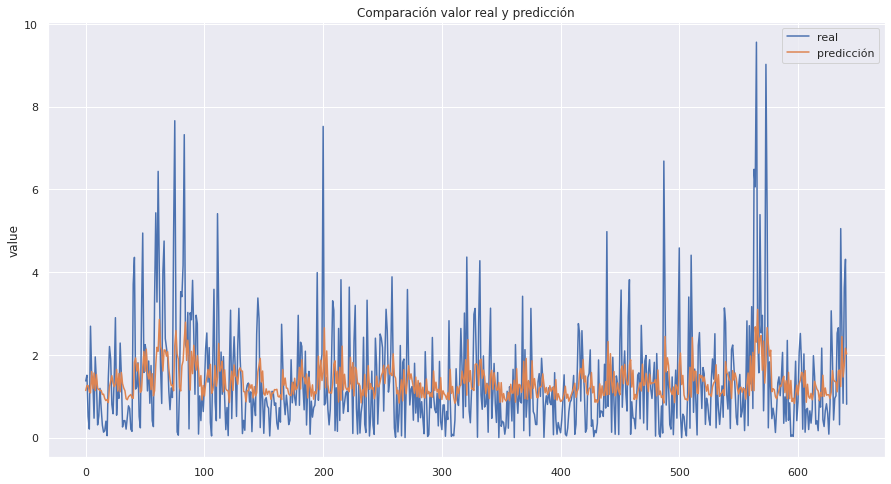

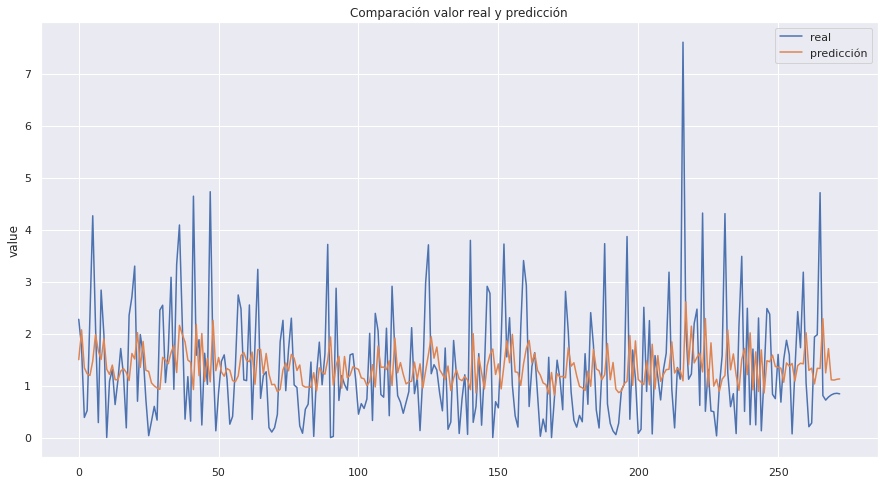

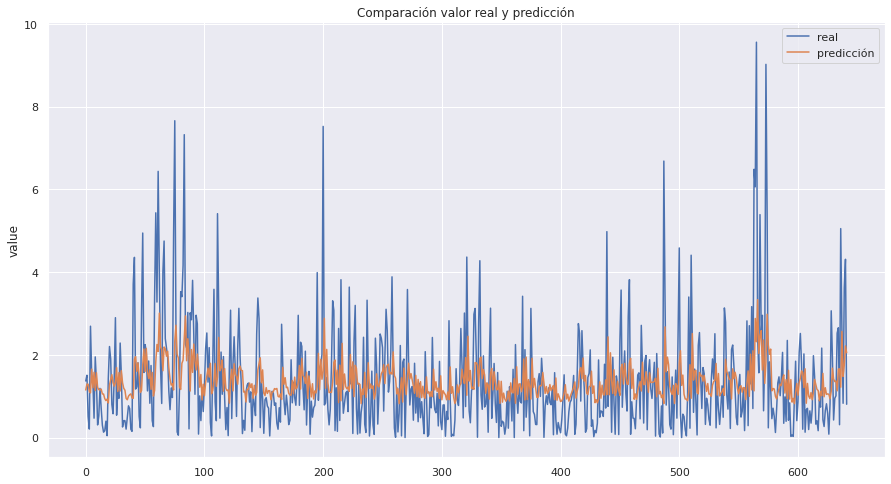

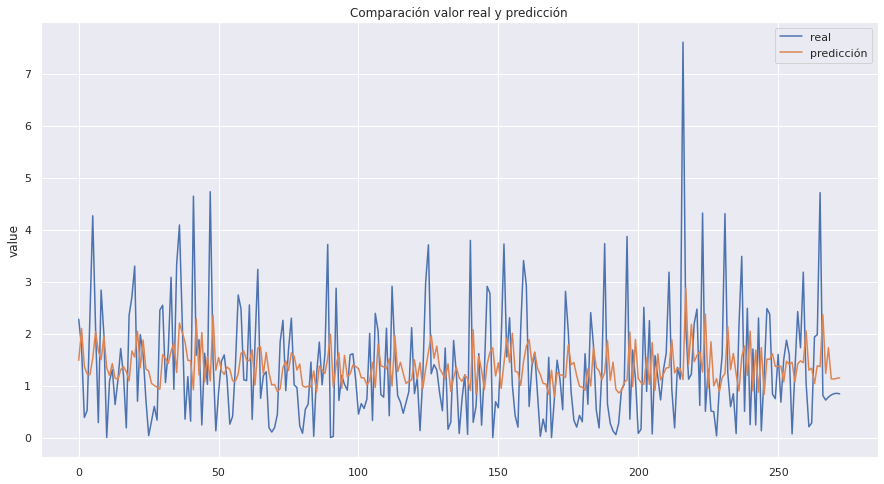

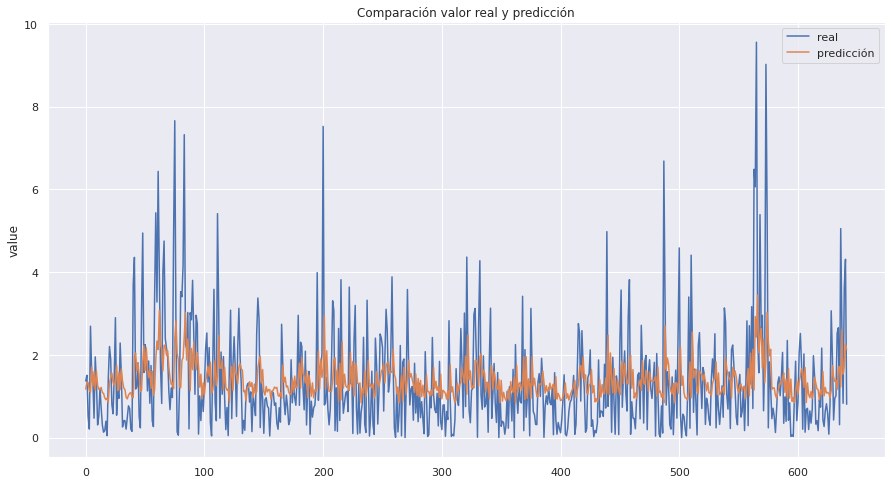

...

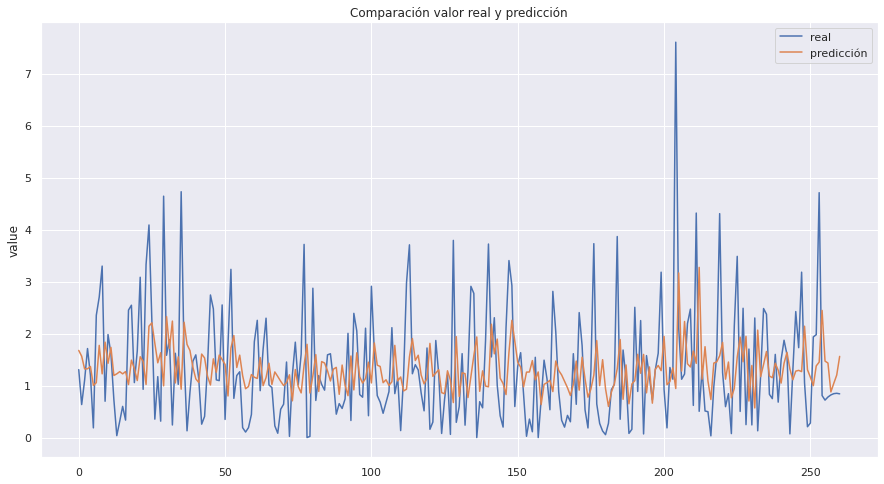

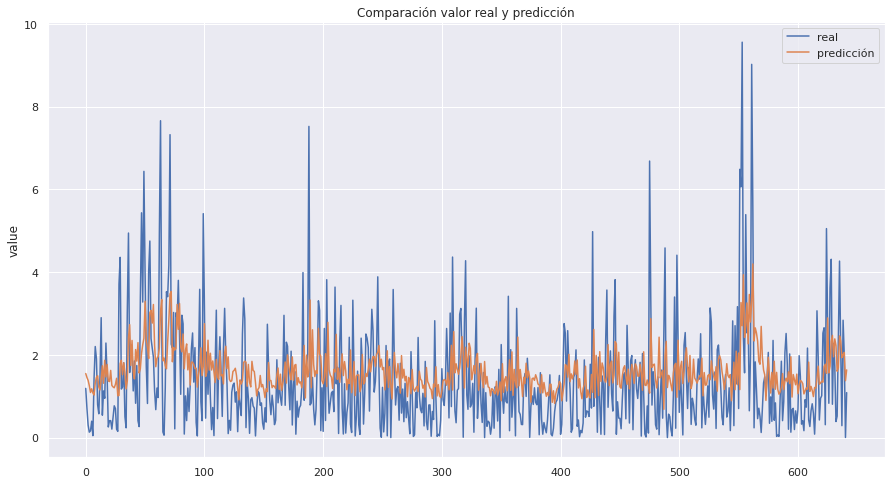

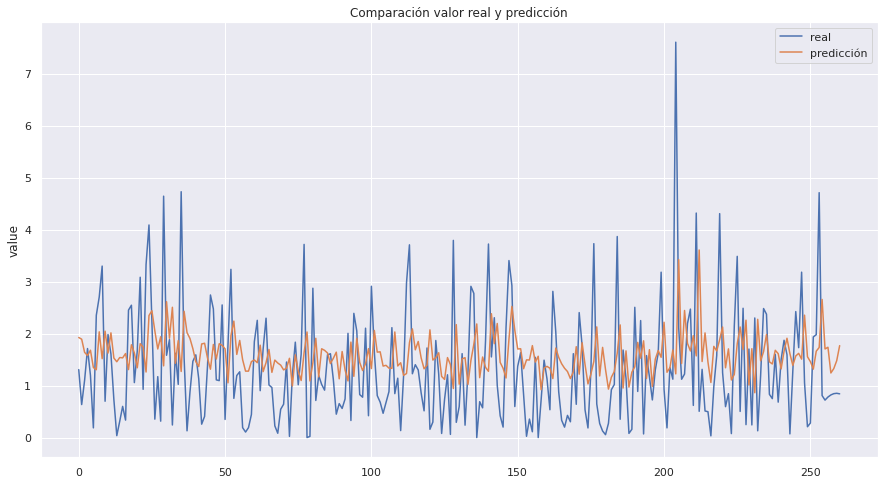

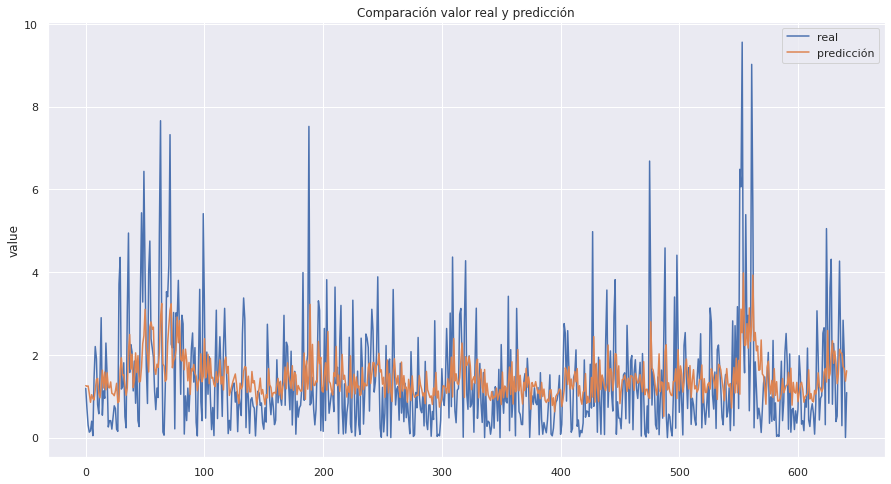

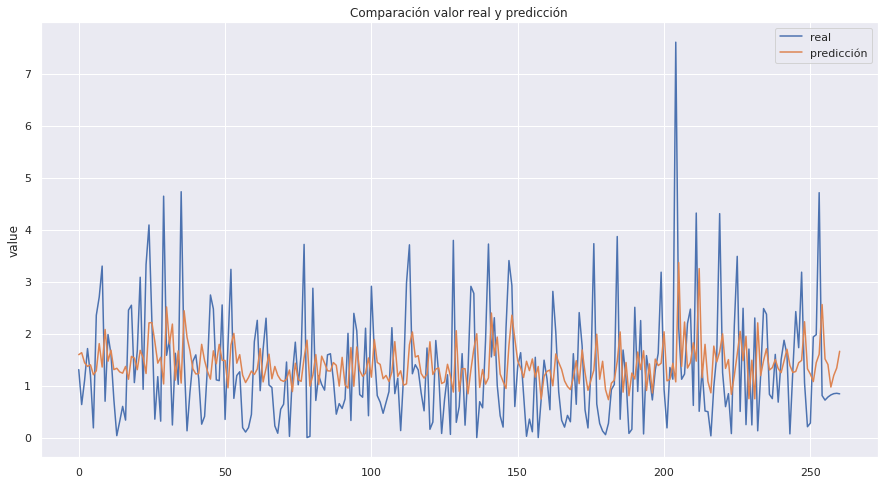

In [32]:
lags=[3,5,7,8,10,15]
n_estimators=[i for i in range(10,100,10)]
n_estimators.extend([200,300,500,2000])
results_models={i:{} for i in lags}
for lg in lags:
    for est in n_estimators:
        results_models[lg][est]=Model(df_data.copy(),df_label.copy(),lg,est)